In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import glob
from netCDF4 import Dataset
import json
%matplotlib inline

In [2]:
# era_AREA = area_grid_cell(lat, 0.375, 0.375)

In [3]:
#nc_path   = '//uio/lagringshotell/geofag/students/metos/hannasv/satelite_coordinates/'
nc_path  = '//home/hanna/lagrings/satelite_coordinates/msthesis/'
save_dir = '/home/hanna/images_simple_statsmodels/'
nc_files  = glob.glob(nc_path + '*.nc')

In [4]:
nc_files

['//home/hanna/lagrings/satelite_coordinates/msthesis/target_grid_slice.nc',
 '//home/hanna/lagrings/satelite_coordinates/msthesis/input_grid_cloud_mask.nc',
 '//home/hanna/lagrings/satelite_coordinates/msthesis/cloud_mask_after_selname.nc',
 '//home/hanna/lagrings/satelite_coordinates/msthesis/cloud_mask.nc']

In [5]:
changed_both = nc_files[-1]

In [6]:
import xarray as xr

In [7]:
data = xr.open_dataset(changed_both)

In [8]:
data

<xarray.Dataset>
Dimensions:    (lat: 3712, lon: 3712)
Coordinates:
    latitude   (lat, lon) float32 ...
    longitude  (lat, lon) float32 ...
Dimensions without coordinates: lat, lon
Data variables:
    cloudMask  (lat, lon) float32 ...
Attributes:
    CDI:                             Climate Data Interface version 1.8.0 (ht...
    Conventions:                     CF-1.0
    history:                         Sat Sep 28 13:25:35 2019: ncatted -a coo...
    source:                          /data/products/1338648/MSG4-SEVI-MSGCLMK...
    institution:                     EUMETSAT
    creator_name:                    EUMETSAT
    creator_url:                     http://archive.eumetsat.int
    creator_email:                   archive@eumetsat.int
    license:                         CopyRight EUMETSAT 2008
    Metadata_Conventions:            Unidata Dataset Discovery v1.0
    title:                           EUMETSAT-ARCHIVE-CLOUD-MASK-NetCDF
    summary:                         NA
    ke

In [9]:
def add(a, b):
    return np.abs(a) + np.abs(b)

def subtract(a, b):
    return np.abs(a) - np.abs(b)

In [10]:
#data = data.drop('latitude')
#data = data.drop('longitude')

In [11]:
data

<xarray.Dataset>
Dimensions:    (lat: 3712, lon: 3712)
Coordinates:
    latitude   (lat, lon) float32 ...
    longitude  (lat, lon) float32 ...
Dimensions without coordinates: lat, lon
Data variables:
    cloudMask  (lat, lon) float32 ...
Attributes:
    CDI:                             Climate Data Interface version 1.8.0 (ht...
    Conventions:                     CF-1.0
    history:                         Sat Sep 28 13:25:35 2019: ncatted -a coo...
    source:                          /data/products/1338648/MSG4-SEVI-MSGCLMK...
    institution:                     EUMETSAT
    creator_name:                    EUMETSAT
    creator_url:                     http://archive.eumetsat.int
    creator_email:                   archive@eumetsat.int
    license:                         CopyRight EUMETSAT 2008
    Metadata_Conventions:            Unidata Dataset Discovery v1.0
    title:                           EUMETSAT-ARCHIVE-CLOUD-MASK-NetCDF
    summary:                         NA
    ke

In [12]:
#data.cloudMask.plot()

In [21]:
rootgrp = Dataset(nc_file, "r", format="NETCDF4")
cloud_mask = rootgrp.variables["cloudMask"][:].data
lat_array = rootgrp.variables["lat"][:].data
lon_array = rootgrp.variables["lon"][:].data
lat_array[lat_array < -99] = np.nan # updates of disk values to nan
lon_array[lon_array < -99] = np.nan # updates of disk values to nan
#d_phi   = lon_array[:, 1:] - lon_array[:, :-1]
#d_theta = lat_array[1:, :] - lat_array[:-1, :]

# Padding the axis -- we removed by taking the difference
#pad     = np.ones((3712, 1))*np.nan # adding numpy to the axis the values
#d_phi   = np.concatenate((pad, d_phi), axis = 1)/2
#d_theta = np.concatenate((pad.transpose(), d_theta), axis = 0)/2

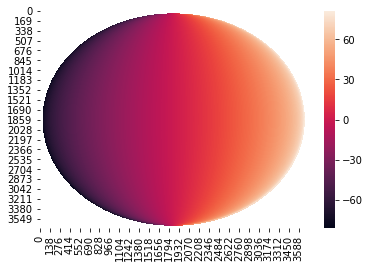

In [134]:
ax = sns.heatmap(lon_array)

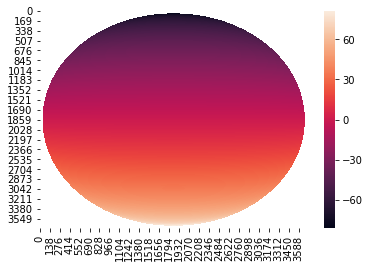

In [135]:
ax = sns.heatmap(lat_array)

In [22]:
rootgrp

<type 'netCDF4._netCDF4.Dataset'>
root group (NETCDF3_CLASSIC data model, file format NETCDF3):
    creator_name: EUMETSAT
    creator_url: http://archive.eumetsat.int
    creator_email: archive@eumetsat.int
    institution: EUMETSAT
    license: CopyRight EUMETSAT 2008
    Conventions: CF-1.0
    Metadata_Conventions: Unidata Dataset Discovery v1.0
    title: EUMETSAT-ARCHIVE-CLOUD-MASK-NetCDF
    summary: NA
    keywords: EUMETSAT, ARCHIVE, NetCDF, CLOUD MASK
    history: EUMETSAT CopyRight 2008
    comment: DRAFT VERSION
    wmo_filename: W_XX-EUMETSAT-Darmstadt,SING+LEV+SAT,MSG4+CLM_C_EUMG_20190613053000.nc
    latitude_of_projection_origin: 0.0
    longitude_of_projection_origin: 0.0
    GRIB_param_Nx: 3712
    GRIB_param_Ny: 3712
    GRIB_orgReferenceTime: 20190613053000
    time_coverage_start: 20190613053000
    time_coverage_end: 20190613053000
    source: /data/products/1338648/MSG4-SEVI-MSGCLMK-0100-0100-20190613053000.000000000Z-20190613054348-1338648.nc.tmp
    dimensions(

In [13]:
def area_grid_cell(c_lat, d_lat, d_lon):
        """
        c_lat : float
            Centre point longitude, latitude in degrees

        d_lat, d_lon : float
            delta lat lon in degrees

        Returns : area in km^2

        cdo : If the grid cell area have to be computed it is scaled with the earth radius to square meters.
        """
        R = 6371000  # in M
        # area er egentlig R**2
        area = R*(np.sin((c_lat + d_lat)*np.pi/180) - np.sin((c_lat - d_lat)*np.pi/180) )*(2*d_lon*np.pi/180) # R**2
        return np.abs(area)


In [14]:
def compute_dDegrees(lat, lon):
    """
    lat, lon shape is (3712, 3712).
    """  
    #assert lat.shape == lon.shape == (3712, 3712), 'Wrong shape of lat and lon expected (3712, 3712), got lat.shape {} and lon.shape {}'.format(lat.shape, lon.shape)
    d_phi      = np.nan*np.zeros(np.shape(lat))
    d_theta    = np.nan*np.zeros(np.shape(lat))
    cell_areas = np.nan*np.zeros(np.shape(lat))
    
    for i in range(1, len(lat)-1):
        for j in range(1, len(lat)-1):
            #left_half_dist     = subtract(lon[i, j],  lon[i, j+1])
            #right_half_dist    = subtract(lon[i, j-1], lon[i, j])                
            #print("left_half_dist {}, right _half_dist {}".format(left_half_dist, right_half_dist))
            dlon               = (subtract(lon[i, j-1],  lon[i, j+1]))/4
            d_phi[i][j]        = dlon

            #upper_half_dist    = subtract(lat[i+1, j], lat[i, j])
            #lower_half_dist    = subtract(lat[i, j], lat[i-1, j])
            #print("upper_half_dist {}, lower_half_dist {}".format(upper_half_dist, lower_half_dist))
            dlat               = subtract(lat[i+1, j], lat[i-1, j])/4
            d_theta[i][j]      = dlat
                
            cell_areas[i][j] = area_grid_cell(lat[i, j], dlat, dlon)       
            
    return d_phi, d_theta, cell_areas

In [15]:
data.longitude.values

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)

In [44]:
l = data.latitude.values

In [47]:
l_sub = l[1000:1500, 1000:1500]

In [49]:
l_sub

array([[-24.864738 , -24.863323 , -24.86191  , ..., -24.405708 ,
        -24.405205 , -24.404703 ],
       [-24.832357 , -24.830944 , -24.829533 , ..., -24.374186 ,
        -24.373684 , -24.373182 ],
       [-24.799988 , -24.798578 , -24.79717  , ..., -24.342676 ,
        -24.342175 , -24.341675 ],
       ...,
       [ -9.974103 ,  -9.973637 ,  -9.973171 , ...,  -9.819929 ,
         -9.8197565,  -9.819585 ],
       [ -9.945777 ,  -9.9453125,  -9.944849 , ...,  -9.792069 ,
         -9.791899 ,  -9.791727 ],
       [ -9.917456 ,  -9.916993 ,  -9.91653  , ...,  -9.7642145,
         -9.764044 ,  -9.763873 ]], dtype=float32)

In [22]:
lat_array = data.latitude.values
lon_array = data.longitude.values

In [16]:
d_phi, d_theta, cell_areas = compute_dDegrees(lat = data.latitude.values, lon = data.longitude.values)

In [38]:
d_phi

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

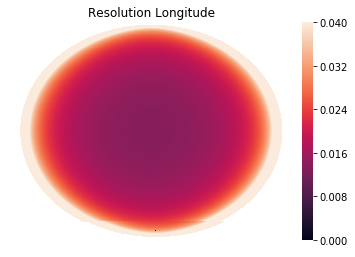

In [18]:
ax = sns.heatmap(np.abs(d_phi), vmax = 0.04)

ax.tick_params(left=False, bottom=False)
ax.set_xticklabels([' '])
ax.set_yticklabels([' '])
ax.set_title('Resolution Longitude')

plt.savefig(save_dir + "resolution_lon.png")

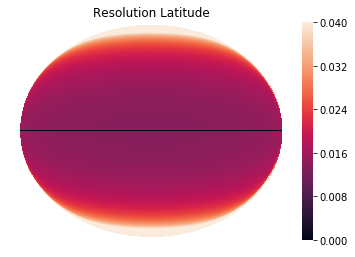

In [19]:
ax2 = sns.heatmap(np.abs(d_theta), vmax = 0.04)
ax2.set_title('Resolution Latitude') 
ax2.set_xticklabels([' '])
ax2.set_yticklabels([' '])
ax2.tick_params(left=False, bottom=False)

plt.savefig(save_dir + "resolution_lat.png")

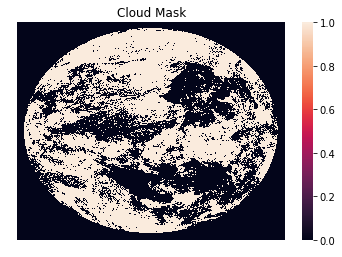

In [20]:
ax2 = sns.heatmap(data.cloudMask.values)
ax2.set_title('Cloud Mask')
ax2.set_xticklabels([' '])
ax2.set_yticklabels([' '])
ax2.tick_params(left=False, bottom=False)

plt.savefig(save_dir + "cloud_mask.png")

In [39]:
lat = 33.75
lon = 12.75

lat = 30.0
lon = 7.5
c_lat   = lat_array.reshape(-1)
c_lon   = lon_array.reshape(-1)
d_theta = d_theta.reshape(-1)
d_phi   = d_phi.reshape(-1)
cloud_mask_array = data.cloudMask.values.reshape(-1) 

In [40]:
era_AREA = area_grid_cell(lat, 0.375, 0.375)
#print("lat = {}, lon ={} era_AREA {}".format(era_AREA, lat, lon))

era_up    = lat + 0.375
era_down  = lat - 0.375

era_left  = lon - 0.375
era_right = lon + 0.375

# to ensure correct sign
cmk_left  = c_lon - np.abs(d_phi)   #- era_right
cmk_right = c_lon + np.abs(d_phi)   #- era_left

# TODO : Sjekk d theta og lignende.
cmk_up    = c_lat + np.abs(d_theta) #- era_down
cmk_down  = c_lat - np.abs(d_theta) #- era_up

idx_left_boundary  = np.intersect1d(np.argwhere(cmk_right > era_left),  np.argwhere(cmk_left < era_left) )
idx_right_boundary = np.intersect1d(np.argwhere(cmk_right > era_right), np.argwhere(cmk_left < era_right) )
idx_up_boundary    = np.intersect1d(np.argwhere(cmk_up > era_up),       np.argwhere(cmk_down < era_up) )
idx_down_boundary  = np.intersect1d(np.argwhere(cmk_up > era_down),     np.argwhere(cmk_down < era_down) )

idx_lower_right_corner = np.intersect1d(idx_down_boundary, idx_right_boundary)
idx_lower_left_corner  = np.intersect1d(idx_down_boundary, idx_left_boundary)
idx_upper_left_corner  = np.intersect1d(idx_up_boundary, idx_left_boundary)
idx_upper_right_corner = np.intersect1d(idx_up_boundary, idx_right_boundary)

corner_idx = np.concatenate([idx_lower_right_corner, idx_lower_left_corner,
                             idx_upper_left_corner, idx_upper_right_corner]) # corner idx

/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:18: RuntimeWarning: invalid value encountered in greater
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:18: RuntimeWarning: invalid value encountered in less
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in greater
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in less
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:20: RuntimeWarning: invalid value encountered in greater
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:20: RuntimeWarning: invalid value encountered in less
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in greater
/

In [48]:
np.intersect1d(idx_left_boundary, idx_right_boundary)

array([12619170])

In [42]:
idx_lower_right_corner

array([10662967])

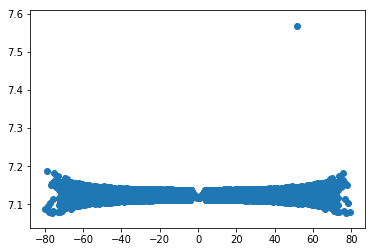

In [49]:
plt.scatter( c_lat[idx_left_boundary], c_lon[idx_left_boundary] )

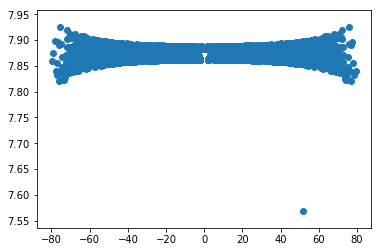

In [50]:
plt.scatter( c_lat[idx_right_boundary], c_lon[idx_right_boundary] )

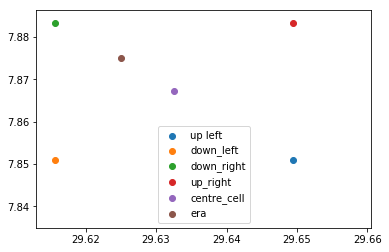

In [45]:
for index in idx_lower_right_corner:
    """ plot Index """
    plt.scatter(cmk_up[index],   cmk_left[index], label = 'up left' )
    plt.scatter(cmk_down[index], cmk_left[index] , label = 'down_left')
    plt.scatter(cmk_down[index], cmk_right[index], label = 'down_right' )
    plt.scatter(cmk_up[index],   cmk_right[index],  label = 'up_right' )
    plt.scatter(c_lat[index],    c_lon[index],  label = 'centre_cell')
    """ plot Scatter era cell """
    plt.scatter(era_down,        era_right, label = 'era') 
    #plt.scatter(era_down,        era_left)
    #plt.scatter(era_up,          era_right)
    #plt.scatter(era_up,          era_left)
plt.legend()
plt.savefig(save_dir+'corner_problem2.png')

In [51]:
def compute_area_one_cell(lat = 60, lon = -15, c_lat = None, 
                          c_lon = None, d_theta = None, d_phi = None, cloud_mask_array = None):
    
    assert c_lon.shape == c_lat.shape == d_theta.shape == d_phi.shape == cloud_mask_array.shape, "c_lon.shape {},  c_lat.shape {},  d_theta.shape {}, d_phi.shape {} cloud_mask_array.shape {}".format(c_lon.shape,  c_lat.shape,  d_theta.shape, d_phi.shape, cloud_mask_array.shape) 
    
    era_AREA = area_grid_cell(lat, 0.375, 0.375)
    print("lat = {}, lon ={} era_AREA {}".format(era_AREA, lat, lon))

    # Make this a loop over lat_lons?
    lat_bondaries = np.array([[lon],
                              [lat]])

    BOUND =  np.array([[-0.75/2, 0.75/2],
                       [-0.75/2, 0.75/2]])

    ranges = lat_bondaries + BOUND

    #lon_range = ranges[0, :]
    #lat_range = ranges[1, :]
    #min_lon, max_lon = lon_range
    #min_lat, max_lat = lat_range

    era_up    = ranges[1, 1]
    era_down  = ranges[1, 0]
    era_left  = ranges[0, 0]
    era_right = ranges[0, 1]

    # to ensure correct sign
    cmk_left  = c_lon - np.abs(d_phi)   #- era_right
    cmk_right = c_lon + np.abs(d_phi)   #- era_left

    # TODO : Sjekk d theta og lignende.
    cmk_up    = c_lat + np.abs(d_theta) #- era_down
    cmk_down  = c_lat - np.abs(d_theta) #- era_up

    idx_left_boundary  = np.intersect1d(np.argwhere(cmk_right > era_left),  np.argwhere(cmk_left < era_left) )
    idx_right_boundary = np.intersect1d(np.argwhere(cmk_right > era_right), np.argwhere(cmk_left < era_right) )
    idx_up_boundary    = np.intersect1d(np.argwhere(cmk_up > era_up), np.argwhere(cmk_down < era_up) )
    idx_down_boundary  = np.intersect1d(np.argwhere(cmk_up > era_down), np.argwhere(cmk_down < era_down) )
    
    idx_lower_right_corner = np.intersect1d(idx_down_boundary, idx_right_boundary)
    idx_lower_left_corner  = np.intersect1d(idx_down_boundary, idx_left_boundary)
    idx_upper_left_corner  = np.intersect1d(idx_up_boundary, idx_left_boundary)
    idx_upper_right_corner = np.intersect1d(idx_up_boundary, idx_right_boundary)

    not_1 = np.intersect1d(idx_left_boundary, idx_right_boundary)
    not_2 = np.intersect1d(idx_up_boundary, idx_down_boundary)
    
    corner_idx         = np.concatenate([idx_lower_right_corner, idx_lower_left_corner,
                                         idx_upper_left_corner, idx_upper_right_corner,
                                        not_1, not_2]) # corner idx
  
    #assert len(corner_idx) == 4, "Not correct number of corners, nbr = {}.".format(len(corner_idx))
    
    # TODO add new centre corners. And calculate  
    llc_dlat = subtract(cmk_up[idx_lower_left_corner], era_down)/2
    llc_dlon = subtract(era_left, cmk_right[idx_lower_left_corner])/2
    llc_lat  = era_down + llc_dlat
    f = area_grid_cell(llc_lat, llc_dlat, llc_dlon)
    #print("area lower left area {}".format(f/era_AREA))
    
    lrc_dlat = subtract(cmk_up[idx_lower_right_corner], era_down)/2
    lrc_dlon = subtract(cmk_left[idx_lower_right_corner], era_right)/2
    lrc_lat  = era_down + lrc_dlat
    h = area_grid_cell(lrc_lat, lrc_dlat, lrc_dlon)
    #print("area lower right area {}".format(h/era_AREA))
    
    ulc_dlat = subtract(era_up, cmk_down[idx_upper_left_corner])/2
    ulc_dlon = subtract(era_left, cmk_right[idx_upper_left_corner])/2
    ulc_lat = era_up - ulc_dlat
    i = area_grid_cell(ulc_lat, ulc_dlat, ulc_dlon)
    #print("area upper left area {}".format(i/era_AREA))
    
    urc_dlat = subtract(era_up, cmk_down[idx_upper_right_corner])/2
    urc_dlon = subtract(cmk_left[idx_upper_right_corner], era_right)/2
    urc_lat  = era_up - ulc_dlat
    j = area_grid_cell(urc_lat, urc_dlat, urc_dlon)
    #print("area upper right area {}".format(j/era_AREA))
    
    #print("SUM corners {}".format((i+j+h+f)/era_AREA))

    if len(corner_idx) == 0:
        raise ValueError('No corners found, something is wrong ... ')
    
    #max_lon, min_lon = np.max(c_lon[corner_idx]), np.min(c_lon[corner_idx])
    #max_lat, min_lat = np.max(c_lat[corner_idx]), np.min(c_lat[corner_idx])

    # removes corners
    for idx in corner_idx:
        idx_down_boundary = idx_down_boundary[idx_down_boundary != idx]
        idx_up_boundary = idx_up_boundary[idx_up_boundary != idx]
        idx_left_boundary = idx_left_boundary[idx_left_boundary != idx]
        idx_right_boundary = idx_right_boundary[idx_right_boundary != idx]
        
    #idx_down_boundary = idx_down_boundary[idx_down_boundary != lower_right_corner]
    #idx_down_boundary = idx_down_boundary[idx_down_boundary != lower_left_corner]

    #idx_up_boundary = idx_up_boundary[idx_up_boundary != upper_right_corner]
    #idx_up_boundary = idx_up_boundary[idx_up_boundary != upper_left_corner]

    #idx_left_boundary = idx_left_boundary[idx_left_boundary != upper_left_corner]
    #idx_left_boundary = idx_left_boundary[idx_left_boundary != lower_left_corner]

    #idx_right_boundary = idx_right_boundary[idx_right_boundary != upper_right_corner]
    #idx_right_boundary = idx_right_boundary[idx_right_boundary != lower_right_corner]
    
    # subsection left boundary OLD
    low_bound = np.argwhere(cmk_down[idx_left_boundary] < era_up  )
    up_bound  = np.argwhere(cmk_up[idx_left_boundary]   > era_down )
    sub_section_left = np.intersect1d(low_bound, up_bound)

    # subsection right boundary
    low_bound = np.argwhere( cmk_down[idx_right_boundary] < era_up )
    up_bound  = np.argwhere( cmk_up[idx_right_boundary] > era_down)
    sub_section_right = np.intersect1d(low_bound, up_bound)

    # Subsection Down Boundary
    one = np.argwhere(cmk_left[idx_down_boundary]  > era_left)
    two = np.argwhere(cmk_right[idx_down_boundary] < era_right)
    sub_section_down = np.intersect1d(one, two)

    # subsection up boundary
    one = np.argwhere( cmk_left[idx_up_boundary]  > era_left)
    two = np.argwhere( cmk_right[idx_up_boundary] < era_right)
    sub_section_up = np.intersect1d(one, two)
    
    #plt.scatter(cmk_left[corner_idx], cmk_up[corner_idx],        marker = 'v')
    #plt.scatter(cmk_left[idx_left_boundary][sub_section_left],   cmk_up[idx_left_boundary][sub_section_left])
    #plt.scatter(cmk_left[idx_right_boundary][sub_section_right], cmk_up[idx_right_boundary][sub_section_right])
    #plt.scatter(cmk_left[idx_up_boundary][sub_section_up],       cmk_up[idx_up_boundary][sub_section_up])
    #plt.scatter(cmk_left[idx_down_boundary][sub_section_down],   cmk_up[idx_down_boundary][sub_section_down])
    #plt.show()
    
    # test that these are empty
    t1 = np.intersect1d(idx_down_boundary, idx_up_boundary)
    t2 = np.intersect1d(idx_right_boundary, idx_left_boundary)
    assert len(t1) == len(t2) == 0, "intercept up down  {}, intersect left right {}.".format(t1, t2)

    # Calculate Boundaries

    # AREA left boundary
    dlon_lf = subtract(cmk_right[idx_left_boundary][sub_section_left], era_left)/2 
    dlat_lf = d_theta[idx_left_boundary][sub_section_left]
    lat_lf  = c_lat[idx_left_boundary][sub_section_left]
    #lon_lf  = c_lon[idx_left_boundary][sub_section_left]

    a = np.sum(area_grid_cell(lat_lf, dlat_lf, np.abs(dlon_lf)))

    fraction_left = (cloud_mask_array[idx_left_boundary][sub_section_left]*area_grid_cell(lat_lf,
                                                                                          dlat_lf,
                                                                                          dlon_lf)/era_AREA).sum()
    # AREA right boundary
    dlon_rb = subtract(era_right, cmk_left[idx_right_boundary][sub_section_right])/2
    dlat_rb = d_theta[idx_right_boundary][sub_section_right]
    lat_rb  = c_lat[idx_right_boundary][sub_section_right]
    #lon_rb = c_lon[idx_right_boundary][sub_section_right]

    b = np.sum(area_grid_cell(lat_rb, dlat_rb, np.abs(dlon_rb)))

    fraction_right = (cloud_mask_array[idx_right_boundary][sub_section_right]*area_grid_cell(lat_rb,
                                                                                             dlat_rb,
                                                                                             dlon_rb)/era_AREA).sum()

    # AREA down boundary
    dlat_down = subtract(era_down, cmk_up[idx_down_boundary][sub_section_down])/2
    lat_down = era_down + dlat_down
    dlon_down = d_phi[idx_down_boundary][sub_section_down]
    #lon_down =  c_lon[idx_down_boundary][sub_section_down]

    c = np.sum(area_grid_cell(lat_down, dlat_down, dlon_down))

    fraction_down = (cloud_mask_array[idx_down_boundary][sub_section_down]*area_grid_cell(lat_down,
                                                                                          dlat_down,
                                                                                          dlon_down)/era_AREA).sum()
    # AREA up
    dlat_up = subtract(era_up, cmk_down[idx_up_boundary][sub_section_up])/2
    lat_up = era_up - dlat_up
    #lon_up = c_lon[idx_up_boundary][sub_section_up]
    dlon_up = d_phi[idx_up_boundary][sub_section_up]

    d = np.sum(area_grid_cell(lat_up, dlat_up, np.abs(dlon_up)))

    fraction_up = (cloud_mask_array[idx_up_boundary][sub_section_up]*area_grid_cell(lat_up,
                                                                 dlat_up,
                                                                 dlon_up)/era_AREA).sum()
    # Index centres. Can safly assume centre cells are correct.
    idx_centre_one = np.intersect1d(np.argwhere(cmk_left  > era_left),
                                    np.argwhere(cmk_right < era_right))


    idx_centre_two = np.intersect1d(np.argwhere(cmk_up   < era_up),
                                    np.argwhere(cmk_down >  era_down))

    idx_centre_cells = np.intersect1d( idx_centre_one, idx_centre_two )
    lat_centre_cells = c_lat[idx_centre_cells]
    dlat_centre      = d_theta[idx_centre_cells]
    dlon_centre      = d_phi[idx_centre_cells]
    
    #plt.scatter(cmk_left[idx_centre_cells], cmk_up[idx_centre_cells])
    #plt.scatter([lon+.375, lon-.375, lon+.375, lon-.375,], [lat+.375, lat+.375, lat-.375,lat-.375])
    #plt.show()
    
    fraction_centre  = (cloud_mask_array[idx_centre_cells]*area_grid_cell(lat_centre_cells,
                                                                 dlat_centre,
                                                                 dlon_centre)/era_AREA).sum()
    #print("era_AREA {}".format(era_AREA))
    #print("Sum up {}".format(area_grid_cell(lat_up, dlat_up, dlon_up).sum()/era_AREA))
    #print("Sum down {}".format(area_grid_cell(lat_down, dlat_down, dlon_down).sum()/era_AREA))
    #print("Sum centre {}".format(area_grid_cell(lat_centre_cells, dlat_centre, dlon_centre).sum() /era_AREA))
    #print("Sum left {}".format(area_grid_cell(lat_lf, dlat_lf, dlon_lf).sum()/era_AREA))
    #print("Sum right {}".format(area_grid_cell(lat_rb, dlat_rb, dlon_rb).sum()/era_AREA))
    
    Test_weight = (area_grid_cell(lat_up, dlat_up, dlon_up).sum() +
                   area_grid_cell(lat_centre_cells, dlat_centre, dlon_centre).sum() +
                   area_grid_cell(lat_down, dlat_down, dlon_down).sum() +
                   area_grid_cell(lat_rb, dlat_rb, dlon_rb).sum() +
                   area_grid_cell(lat_lf, dlat_lf, dlon_lf).sum() ) /era_AREA# + (i+j+h+f)/era_AREA
    
    print("SUM weight {}".format(Test_weight[0]))
    return Test_weight[0]


In [60]:
#lats = 
#lons = np.arange(-15, 30, 0.75)

def store_area_index_info(lats = np.arange(30, 56, 0.75), lons = np.arange(-15, 30, 0.75), 
                          c_lat = None, c_lon = None, d_theta = None, d_phi = None, cloud_mask_array = None, 
                          write_fil = False):
    
    assert c_lon.shape == c_lat.shape == d_theta.shape == d_phi.shape == cloud_mask_array.shape, " c_lon.shape {},  c_lat.shape {},  d_theta.shape {}, d_phi.shape {} cloud_mask_array.shape {}".format(c_lon.shape,  c_lat.shape,  d_theta.shape, d_phi.shape, cloud_mask_array.shape) 
    hh=[]
    data = {}
    for lat in lats:
        data[str(lat)] = {}
        for lon in lons:
            data[str(lat)][str(lon)] = {}
            era_AREA = area_grid_cell(lat, 0.375, 0.375)
            print("lat = {}, lon = {}".format(lat, lon))
            era_up    = lat + 0.375
            era_down  = lat - 0.375
            era_left  = lon - 0.375
            era_right = lon + 0.375

            # to ensure correct sign
            cmk_left  = c_lon - np.abs(d_phi)   #- era_right
            cmk_right = c_lon + np.abs(d_phi)   #- era_left

            # TODO : Sjekk d theta og lignende.
            cmk_up    = c_lat + np.abs(d_theta) #- era_down
            cmk_down  = c_lat - np.abs(d_theta) #- era_up
            
            data[str(lat)][str(lon)]['centre'] = {}
            data[str(lat)][str(lon)]['down'] = {}
            data[str(lat)][str(lon)]['up'] = {}
            data[str(lat)][str(lon)]['right'] = {}
            data[str(lat)][str(lon)]['left'] = {}
            data[str(lat)][str(lon)]['corner'] = {}
            
            idx_left_boundary  = np.intersect1d(np.argwhere(cmk_right > era_left),  np.argwhere(cmk_left < era_left) )
            idx_right_boundary = np.intersect1d(np.argwhere(cmk_right > era_right), np.argwhere(cmk_left < era_right) )
            idx_up_boundary    = np.intersect1d(np.argwhere(cmk_up > era_up),       np.argwhere(cmk_down < era_up) )
            idx_down_boundary  = np.intersect1d(np.argwhere(cmk_up > era_down),     np.argwhere(cmk_down < era_down) )

            data[str(lat)][str(lon)]['down']['index']  = idx_down_boundary
            data[str(lat)][str(lon)]['up']['index']    = idx_up_boundary
            data[str(lat)][str(lon)]['left']['index']  = idx_left_boundary
            data[str(lat)][str(lon)]['right']['index'] = idx_right_boundary
            
            idx_lower_right_corner = np.intersect1d(idx_down_boundary, idx_right_boundary)
            idx_lower_left_corner  = np.intersect1d(idx_down_boundary, idx_left_boundary)
            idx_upper_left_corner  = np.intersect1d(idx_up_boundary, idx_left_boundary)
            idx_upper_right_corner = np.intersect1d(idx_up_boundary, idx_right_boundary)
            """
            corner_idx         = np.concatenate([idx_lower_right_corner, idx_lower_left_corner,
                                                 idx_upper_left_corner, idx_upper_right_corner]) # corner idx
            data['corner']['index'] = corner_idx
            #assert len(corner_idx) == 4, "Not correct number of corners, nbr = {}.".format(len(corner_idx))
            
            if len(corner_idx) != 4:
                print("left bound {}".format(cmk_left[corner_idx]))
                print("right bound {}".format(cmk_right[corner_idx]))
                print("up bound {}".format(cmk_up[corner_idx]))
                print("down bound {}".format(cmk_down[corner_idx]))
                
            # TODO add new centre corners. And calculate  
            llc_dlat = subtract(cmk_up[idx_lower_left_corner], era_down)/2
            llc_dlon = subtract(era_left, cmk_right[idx_lower_left_corner])/2
            llc_lat  = era_down + llc_dlat
            
            llc_area = area_grid_cell(llc_lat, llc_dlat, llc_dlon)
            #print("area lower left area {}".format(f/era_AREA))

            lrc_dlat = subtract(cmk_up[idx_lower_right_corner], era_down)/2
            lrc_dlon = subtract(cmk_left[idx_lower_right_corner], era_right)/2
            
            lrc_lat  = era_down + lrc_dlat
            lrc_area = area_grid_cell(lrc_lat, lrc_dlat, lrc_dlon)
            #print("area lower right area {}".format(h/era_AREA))

            ulc_dlat = subtract(era_up, cmk_down[idx_upper_left_corner])/2
            ulc_dlon = subtract(era_left, cmk_right[idx_upper_left_corner])/2
            ulc_lat = era_up - ulc_dlat
            ulc_area = area_grid_cell(ulc_lat, ulc_dlat, ulc_dlon)
            #print("area upper left area {}".format(i/era_AREA))

            urc_dlat = subtract(era_up, cmk_down[idx_upper_right_corner])/2
            urc_dlon = subtract(cmk_left[idx_upper_right_corner], era_right)/2
            urc_lat  = era_up - ulc_dlat
            urc_area = area_grid_cell(urc_lat, urc_dlat, urc_dlon)
            #print("area upper right area {}".format(j/era_AREA))
            #print("SUM corners {}".format((i+j+h+f)/era_AREA))

            corner_areas = np.array([lrc_area, llc_area, ulc_area, urc_area])
            data['corner']['area'] = corner_areas
            
            if len(corner_idx) == 0:
                raise ValueError('No corners found, something is wrong ... ')
            """
            #assert len(corner_idx) == 4, "Expected four corners, got {}".format(len(corner_idx))
                           
            #max_lon, min_lon = np.max(c_lon[corner_idx]), np.min(c_lon[corner_idx])
            #max_lat, min_lat = np.max(c_lat[corner_idx]), np.min(c_lat[corner_idx])

            # removes corners
            for idx in corner_idx:
                idx_down_boundary = idx_down_boundary[idx_down_boundary != idx]
                idx_up_boundary = idx_up_boundary[idx_up_boundary != idx]
                idx_left_boundary = idx_left_boundary[idx_left_boundary != idx]
                idx_right_boundary = idx_right_boundary[idx_right_boundary != idx]

            #idx_down_boundary = idx_down_boundary[idx_down_boundary != lower_right_corner]
            #idx_down_boundary = idx_down_boundary[idx_down_boundary != lower_left_corner]

            #idx_up_boundary = idx_up_boundary[idx_up_boundary != upper_right_corner]
            #idx_up_boundary = idx_up_boundary[idx_up_boundary != upper_left_corner]

            #idx_left_boundary = idx_left_boundary[idx_left_boundary != upper_left_corner]
            #idx_left_boundary = idx_left_boundary[idx_left_boundary != lower_left_corner]

            #idx_right_boundary = idx_right_boundary[idx_right_boundary != upper_right_corner]
            #idx_right_boundary = idx_right_boundary[idx_right_boundary != lower_right_corner]

            # subsection left boundary OLD
            low_bound = np.argwhere(cmk_down[idx_left_boundary] < era_up  )
            up_bound  = np.argwhere(cmk_up[idx_left_boundary]   > era_down )
            sub_section_left = np.intersect1d(low_bound, up_bound)
            
            data[str(lat)][str(lon)]['left']['index_subset'] = sub_section_left
            
            # subsection right boundary
            low_bound = np.argwhere( cmk_down[idx_right_boundary] < era_up )
            up_bound  = np.argwhere( cmk_up[idx_right_boundary] > era_down)
            sub_section_right = np.intersect1d(low_bound, up_bound)
            data[str(lat)][str(lon)]['right']['index_right'] = sub_section_right
            
            # Subsection Down Boundary
            one = np.argwhere(cmk_left[idx_down_boundary]  > era_left)
            two = np.argwhere(cmk_right[idx_down_boundary] < era_right)
            sub_section_down = np.intersect1d(one, two)
            data[str(lat)][str(lon)]['down']['index_subset'] = sub_section_down

            # subsection up boundary
            one = np.argwhere( cmk_left[idx_up_boundary]  > era_left)
            two = np.argwhere( cmk_right[idx_up_boundary] < era_right)
            sub_section_up = np.intersect1d(one, two)
            data[str(lat)][str(lon)]['up']['index_subset'] = sub_section_up
            #plt.scatter(cmk_left[corner_idx], cmk_up[corner_idx],        marker = 'v')
            #plt.scatter(cmk_left[idx_left_boundary][sub_section_left],   cmk_up[idx_left_boundary][sub_section_left])
            #plt.scatter(cmk_left[idx_right_boundary][sub_section_right], cmk_up[idx_right_boundary][sub_section_right])
            #plt.scatter(cmk_left[idx_up_boundary][sub_section_up],       cmk_up[idx_up_boundary][sub_section_up])
            #plt.scatter(cmk_left[idx_down_boundary][sub_section_down],   cmk_up[idx_down_boundary][sub_section_down])
            #plt.show()

            # test that these are empty
            #t1 = np.intersect1d(idx_down_boundary, idx_up_boundary)
            #t2 = np.intersect1d(idx_right_boundary, idx_left_boundary)
            # assert len(t1) == len(t2) == 0, "intercept up down  {}, intersect left right {}.".format(t1, t2)

            # Calculate Boundaries

            # AREA left boundary
            dlon_lf = subtract(cmk_right[idx_left_boundary][sub_section_left], era_left)/2 
            dlat_lf = d_theta[idx_left_boundary][sub_section_left]
            lat_lf  = c_lat[idx_left_boundary][sub_section_left]
            #lon_lf  = c_lon[idx_left_boundary][sub_section_left]
            left_areas = area_grid_cell(lat_lf, dlat_lf, np.abs(dlon_lf))
            data[str(lat)][str(lon)]['left']['area'] = left_areas
            
            a = np.sum(left_areas)

            fraction_left = (cloud_mask_array[idx_left_boundary][sub_section_left]*area_grid_cell(lat_lf,
                                                                                                  dlat_lf,
                                                                                                  dlon_lf)/era_AREA).sum()
            # AREA right boundary
            dlon_rb = subtract(era_right, cmk_left[idx_right_boundary][sub_section_right])/2
            dlat_rb = d_theta[idx_right_boundary][sub_section_right]
            lat_rb  = c_lat[idx_right_boundary][sub_section_right]
            #lon_rb = c_lon[idx_right_boundary][sub_section_right]
            right_area = area_grid_cell(lat_rb, dlat_rb, np.abs(dlon_rb)) 
            data[str(lat)][str(lon)]['right']['area'] = right_area
            b = np.sum(right_area)

            fraction_right = (cloud_mask_array[idx_right_boundary][sub_section_right]*area_grid_cell(lat_rb,
                                                                                                     dlat_rb,
                                                                                                     dlon_rb)/era_AREA).sum()

            # AREA down boundary
            dlat_down = subtract(era_down, cmk_up[idx_down_boundary][sub_section_down])/2
            lat_down = era_down + dlat_down
            dlon_down = d_phi[idx_down_boundary][sub_section_down]
            #lon_down =  c_lon[idx_down_boundary][sub_section_down]
            down_area = area_grid_cell(lat_down, dlat_down, dlon_down)
            c = np.sum(down_area)
            data[str(lat)][str(lon)]['down']['area'] = down_area
            fraction_down = (cloud_mask_array[idx_down_boundary][sub_section_down]*area_grid_cell(lat_down,
                                                                                                  dlat_down,
                                                                                                  dlon_down)/era_AREA).sum()
            # AREA up
            dlat_up = subtract(era_up, cmk_down[idx_up_boundary][sub_section_up])/2
            lat_up = era_up - dlat_up
            #lon_up = c_lon[idx_up_boundary][sub_section_up]
            dlon_up = d_phi[idx_up_boundary][sub_section_up]
            up_area = area_grid_cell(lat_up, dlat_up, np.abs(dlon_up))
            data[str(lat)][str(lon)]['up']['area'] = up_area
            d = np.sum(up_area)

            fraction_up = (cloud_mask_array[idx_up_boundary][sub_section_up]*area_grid_cell(lat_up,
                                                                                             dlat_up,
                                                                                             dlon_up)/era_AREA).sum()
            # Index centres. Can safly assume centre cells are correct.
            idx_centre_one = np.intersect1d(np.argwhere(cmk_left  > era_left),
                                            np.argwhere(cmk_right < era_right))


            idx_centre_two = np.intersect1d(np.argwhere(cmk_up   < era_up),
                                            np.argwhere(cmk_down >  era_down))

            idx_centre_cells = np.intersect1d( idx_centre_one, idx_centre_two )
            data[str(lat)][str(lon)]['centre']['index'] = idx_centre_cells
            
            lat_centre_cells = c_lat[idx_centre_cells]
            dlat_centre      = d_theta[idx_centre_cells]
            dlon_centre      = d_phi[idx_centre_cells]
            centre_area      = area_grid_cell(lat_centre_cells, dlat_centre, dlon_centre)
            
            data[str(lat)][str(lon)]['centre']['area'] = centre_area
            #plt.scatter(cmk_left[idx_centre_cells], cmk_up[idx_centre_cells])
            #plt.scatter([lon+.375, lon-.375, lon+.375, lon-.375,], [lat+.375, lat+.375, lat-.375,lat-.375])
            #plt.show()

            fraction_centre  = (cloud_mask_array[idx_centre_cells]*centre_area/era_AREA).sum()
            sum_up = area_grid_cell(lat_up, dlat_up, dlon_up).sum()/era_AREA
            sum_down = area_grid_cell(lat_down, dlat_down, dlon_down).sum()/era_AREA
            sum_centre = area_grid_cell(lat_centre_cells, dlat_centre, dlon_centre).sum() /era_AREA
            sum_left = area_grid_cell(lat_lf, dlat_lf, dlon_lf).sum()/era_AREA 
            sum_right = area_grid_cell(lat_rb, dlat_rb, dlon_rb).sum()/era_AREA
            #print("era_AREA {}".format(era_AREA))
            
            sumsum = sum_up + sum_down + sum_centre + sum_left + sum_right
            print("Sum up {}".format(sum_up))
            print("Sum down {}".format(sum_down))
            print("Fraction centre {}".format(sum_centre))
            print("Sum left {}".format(sum_left))
            print("Sum right {}".format(sum_right))
            print("\n")
            print("sum all {}".format(sumsum))
            hh.append(sumsum)
            # Test_weight = (area_grid_cell(lat_up, dlat_up, dlon_up).sum() +
            #               area_grid_cell(lat_centre_cells, dlat_centre, dlon_centre).sum() +
            #               area_grid_cell(lat_down, dlat_down, dlon_down).sum() +
            #               area_grid_cell(lat_rb, dlat_rb, dlon_rb).sum() +
            #               area_grid_cell(lat_lf, dlat_lf, dlon_lf).sum() ) /era_AREA + (i+j+h+f)/era_AREA

        #print("SUM weight {}".format(Test_weight[0]))
        print(data)
    return data, hh


In [61]:
data_dict, hh = store_area_index_info(lats = np.arange(30, 56, 0.75), lons = np.arange(-15, 30, 0.75), 
                                  c_lat = lat_array.reshape(-1), 
                                  c_lon = lon_array.reshape(-1), d_theta = d_theta.reshape(-1), 
                                  d_phi = d_phi.reshape(-1), cloud_mask_array = cloud_mask_array.reshape(-1),
                                  write_fil = False)

lat = 30.0, lon = -15.0


/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:37: RuntimeWarning: invalid value encountered in greater
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:37: RuntimeWarning: invalid value encountered in less
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in greater
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in less
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:39: RuntimeWarning: invalid value encountered in greater
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:39: RuntimeWarning: invalid value encountered in less
/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:40: RuntimeWarning: invalid value encountered in greater
/

Sum up 0.020717908553291198
Sum down 0.01967012895930414
Fraction centre 0.9197326645030672
Sum left 0.024380020338157168
Sum right 0.02315489559133185


sum all 1.0076556179451515
lat = 30.0, lon = -14.25
Sum up 0.024718522498639196
Sum down 0.020394754583355525
Fraction centre 0.9138893963141224
Sum left 0.023813693780568426
Sum right 0.022852233972403022


sum all 1.0056686011490885
lat = 30.0, lon = -13.5
Sum up 0.01803457181913753
Sum down 0.024527756834416943
Fraction centre 0.9186186874691848
Sum left 0.023812268756956117
Sum right 0.021505454675088884


sum all 1.0064987395547842
lat = 30.0, lon = -12.75
Sum up 0.02777307572910171
Sum down 0.01765902795725597
Fraction centre 0.9112984704197551
Sum left 0.02489989422854217
Sum right 0.023858386745209296


sum all 1.0054888550798642
lat = 30.0, lon = -12.0
Sum up 0.014545501502569995
Sum down 0.025773747138767827
Fraction centre 0.9186235826962671
Sum left 0.0222793129537931
Sum right 0.023766811565476394


sum all 1.004988955856

Sum up 0.017360076756651233
Sum down 0.02873887573266192
Fraction centre 0.9156569521832288
Sum left 0.022883476393203254
Sum right 0.022571051205026227


sum all 1.0072104322707713
lat = 30.0, lon = 16.5
Sum up 0.029366624008514284
Sum down 0.013908805852848852
Fraction centre 0.9177656137983445
Sum left 0.025034463602406864
Sum right 0.021590914789265423


sum all 1.00766642205138
lat = 30.0, lon = 17.25
Sum up 0.01914239797547696
Sum down 0.02377638587149764
Fraction centre 0.9142105374804823
Sum left 0.026347888658548625
Sum right 0.024805319763042184


sum all 1.0082825297490476
lat = 30.0, lon = 18.0
Sum up 0.01790781121469968
Sum down 0.02683365806795942
Fraction centre 0.9170556622242716
Sum left 0.023484658130358875
Sum right 0.02351294475391078


sum all 1.0087947343912003
lat = 30.0, lon = 18.75
Sum up 0.02808904561018631
Sum down 0.016501703753889683
Fraction centre 0.915806147271044
Sum left 0.02517880663655035
Sum right 0.023465989103812906


sum all 1.0090416923754832
la

Sum up 0.030249572098970647
Sum down 0.022756583115514824
Fraction centre 0.9076029496807955
Sum left 0.024523650190829978
Sum right 0.023156041271567018


sum all 1.008288796357678
lat = 30.75, lon = -14.25
Sum up 0.015966641014279172
Sum down 0.018447677271985236
Fraction centre 0.9247535402843294
Sum left 0.024798394802724274
Sum right 0.023733868372601087


sum all 1.0077001217459192
lat = 30.75, lon = -13.5
Sum up 0.025493628685668287
Sum down 0.02698416056436308
Fraction centre 0.9026728164301068
Sum left 0.023908891487196913
Sum right 0.027623496146380364


sum all 1.0066829933137154
lat = 30.75, lon = -12.75
Sum up 0.02049805456072297
Sum down 0.014862864268776626
Fraction centre 0.9283249482516961
Sum left 0.019755588256596672
Sum right 0.02261112608324315


sum all 1.0060525814210355
lat = 30.75, lon = -12.0
Sum up 0.024736411666625567
Sum down 0.030010503598462236
Fraction centre 0.9009706462273107
Sum left 0.024491417195708118
Sum right 0.02558820505522967


sum all 1.00579

Sum up 0.03024957209897065
Sum down 0.02275658311551482
Fraction centre 0.9076029496807954
Sum left 0.023156041271567018
Sum right 0.024523650190829978


sum all 1.0082887963576779
lat = 30.75, lon = 15.75
Sum up 0.017918080143454133
Sum down 0.026431484938177846
Fraction centre 0.9137327186471342
Sum left 0.023732603645429954
Sum right 0.024751534908605353


sum all 1.0065664222828015
lat = 30.75, lon = 16.5
Sum up 0.023166302090606977
Sum down 0.014628567244502184
Fraction centre 0.9222241634659339
Sum left 0.021726967979445955
Sum right 0.026166205948546385


sum all 1.0079122067290354
lat = 30.75, lon = 17.25
Sum up 0.027102242849464386
Sum down 0.02526900521070469
Fraction centre 0.9098438670931918
Sum left 0.022780370015491942
Sum right 0.024510146621929532


sum all 1.0095056317907825
lat = 30.75, lon = 18.0
Sum up 0.019216849452186834
Sum down 0.026859947422479453
Fraction centre 0.9147531182472401
Sum left 0.024797790916396625
Sum right 0.023081020244085773


sum all 1.0087087

Sum up 0.013385128672955902
Sum down 0.014067793863082597
Fraction centre 0.9314807007731996
Sum left 0.023812063049512635
Sum right 0.023818391670857787


sum all 1.0065640780296086
lat = 31.5, lon = -14.25
Sum up 0.02721189065007736
Sum down 0.028197444454076397
Fraction centre 0.9043039533507493
Sum left 0.023035828665320036
Sum right 0.024275316240913697


sum all 1.007024433361137
lat = 31.5, lon = -13.5
Sum up 0.020295917228629497
Sum down 0.01832306233606619
Fraction centre 0.9200104114988625
Sum left 0.024403814867160648
Sum right 0.023388243642500327


sum all 1.0064214495732193
lat = 31.5, lon = -12.75
Sum up 0.022681769271325012
Sum down 0.02519562098063466
Fraction centre 0.9105491121682981
Sum left 0.022900731836335526
Sum right 0.024486055509313102


sum all 1.0058132897659064
lat = 31.5, lon = -12.0
Sum up 0.023050833988672293
Sum down 0.018601405581743276
Fraction centre 0.9182127287446851
Sum left 0.023639848814407168
Sum right 0.021641164293767858


sum all 1.00514598

Sum up 0.030417288797052165
Sum down 0.026809182875396933
Fraction centre 0.9033190469404982
Sum left 0.023337127227664123
Sum right 0.023780393501675365


sum all 1.0076630393422867
lat = 31.5, lon = 16.5
Sum up 0.020728316729822154
Sum down 0.021830643216822036
Fraction centre 0.9161730511379069
Sum left 0.02585642485021158
Sum right 0.02437644693284383


sum all 1.0089648828676065
lat = 31.5, lon = 17.25
Sum up 0.016066424341823246
Sum down 0.01819805583065388
Fraction centre 0.9251984133418649
Sum left 0.023450532240644674
Sum right 0.02475042486564633


sum all 1.007663850620633
lat = 31.5, lon = 18.0
Sum up 0.028350366460137034
Sum down 0.02431956096584049
Fraction centre 0.9081432898374519
Sum left 0.02342925070405283
Sum right 0.02680792032580677


sum all 1.0110503882932889
lat = 31.5, lon = 18.75
Sum up 0.02313313406969669
Sum down 0.027019229082747735
Fraction centre 0.9088146866354441
Sum left 0.023967592991659306
Sum right 0.027232514728708457


sum all 1.0101671575082563


Sum up 0.02531330935208006
Sum down 0.032063700710570166
Fraction centre 0.9019614169924353
Sum left 0.023295747995990244
Sum right 0.02483938842118217


sum all 1.007473563472258
lat = 32.25, lon = -14.25
Sum up 0.018031921409082084
Sum down 0.017819319081506316
Fraction centre 0.9243961782635751
Sum left 0.023042486453330877
Sum right 0.023351345490822437


sum all 1.006641250698317
lat = 32.25, lon = -13.5
Sum up 0.033194322811751276
Sum down 0.024525913782436095
Fraction centre 0.9014943000358584
Sum left 0.024246605519014874
Sum right 0.023529408680982973


sum all 1.0069905508300436
lat = 32.25, lon = -12.75
Sum up 0.012208701273522997
Sum down 0.021865770802858578
Fraction centre 0.9222522752848445
Sum left 0.025938984622907786
Sum right 0.024628707454286983


sum all 1.006894439438421
lat = 32.25, lon = -12.0
Sum up 0.03296688426081585
Sum down 0.02336826023616081
Fraction centre 0.904341705577054
Sum left 0.02242706052813456
Sum right 0.02221765928713766


sum all 1.0053215698

Sum up 0.025313309352080066
Sum down 0.032063700710570166
Fraction centre 0.9019614169924353
Sum left 0.02483938842118217
Sum right 0.023295747995990244


sum all 1.007473563472258
lat = 32.25, lon = 15.75
Sum up 0.025439772327148967
Sum down 0.015182740621655684
Fraction centre 0.9166758576878097
Sum left 0.027095572277545877
Sum right 0.025192234162774586


sum all 1.0095861770769348
lat = 32.25, lon = 16.5
Sum up 0.016992241090673307
Sum down 0.023083714992145742
Fraction centre 0.9189117769510957
Sum left 0.023344833168968855
Sum right 0.02680851506950357


sum all 1.009141081272387
lat = 32.25, lon = 17.25
Sum up 0.02600042349781058
Sum down 0.030329738810203014
Fraction centre 0.9078403558427482
Sum left 0.022069088224971462
Sum right 0.023115520510722316


sum all 1.0093551268864556
lat = 32.25, lon = 18.0
Sum up 0.026032339904405368
Sum down 0.016059859162740584
Fraction centre 0.9170518192420533
Sum left 0.02838100601774728
Sum right 0.024019697429339962


sum all 1.0115447217

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.024525630859095936
Sum down 0.021052804650151552
Fraction centre 0.9135492213471076
Sum left 0.02374946613768146
Sum right 0.025339868212710302


sum all 1.008216991206747
lat = 33.0, lon = -14.25
Sum up 0.018137135822387965
Sum down 0.028105041952725892
Fraction centre 0.9122575075662773
Sum left 0.02363015953961912
Sum right 0.025056282162714497


sum all 1.0071861270437248
lat = 33.0, lon = -13.5
Sum up 0.03193120409613576
Sum down 0.012515685502172073
Fraction centre 0.9131534991205812
Sum left 0.023623818385099853
Sum right 0.025254365390942037


sum all 1.0064785724949308
lat = 33.0, lon = -12.75
Sum up 0.011923172408262843
Sum down 0.033438591284840204
Fraction centre 0.9126272557022491
Sum left 0.023154403785144027
Sum right 0.02616186360903346


sum all 1.0073052867895296
lat = 33.0, lon = -12.0
Sum up 0.03364111485962496
Sum down 0.012237775818870728
Fraction centre 0.9139659245750794
Sum left 0.021961438678517128
Sum right 0.024689825275925652


sum all 1.0064960792

Sum up 0.025185214618920704
Sum down 0.019005748364133875
Fraction centre 0.9152108012427447
Sum left 0.025564643663237522
Sum right 0.02367390135944374


sum all 1.0086403092484806
lat = 33.0, lon = 16.5
Sum up 0.015609512268895964
Sum down 0.030100555843644978
Fraction centre 0.9128023754731932
Sum left 0.02596973656282678
Sum right 0.024497165138277866


sum all 1.0089793452868387
lat = 33.0, lon = 17.25
Sum up 0.025606626066936866
Sum down 0.01909180305281727
Fraction centre 0.9148692721630497
Sum left 0.02549639721570214
Sum right 0.02536931467640007


sum all 1.0104334131749062
lat = 33.0, lon = 18.0
Sum up 0.027371176212238668
Sum down 0.019408921505815007
Fraction centre 0.9127936773277062
Sum left 0.02502931316745239
Sum right 0.02666925866885253


sum all 1.0112723468820648
lat = 33.0, lon = 18.75
Sum up 0.020624427479076016
Sum down 0.025840307026618492
Fraction centre 0.9133727608536741
Sum left 0.02412094545960705
Sum right 0.02799267376818788


sum all 1.0119511145871636


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.015306273636213076
Sum down 0.02065399755434603
Fraction centre 0.9213582285150506
Sum left 0.02521382100853262
Sum right 0.02550644353513696


sum all 1.0080387642492792
lat = 33.75, lon = -14.25
Sum up 0.026635576170482737
Sum down 0.029073753810927416
Fraction centre 0.9018184009229315
Sum left 0.024618403506192602
Sum right 0.026164193165950537


sum all 1.0083103275764849
lat = 33.75, lon = -13.5
Sum up 0.020387422922614563
Sum down 0.012615206878070695
Fraction centre 0.9256116066921448
Sum left 0.023663383083503756
Sum right 0.027025531840163357


sum all 1.0093031514164972
lat = 33.75, lon = -12.75
Sum up 0.02471365463916314
Sum down 0.03256048469486214
Fraction centre 0.9024494360164775
Sum left 0.022489188857710615
Sum right 0.024222735632268077


sum all 1.0064354998404814
lat = 33.75, lon = -12.0
Sum up 0.024717602395076848
Sum down 0.0126111547802561
Fraction centre 0.9175899753645678
Sum left 0.02503215844025817
Sum right 0.025092517544079398


sum all 1.00504340

Sum up 0.015306273636213074
Sum down 0.020653997554346028
Fraction centre 0.9213582285150506
Sum left 0.02550644353513696
Sum right 0.02521382100853262


sum all 1.0080387642492792
lat = 33.75, lon = 15.75
Sum up 0.028885334521929356
Sum down 0.022584485352175943
Fraction centre 0.9091403907643193
Sum left 0.02295198768468419
Sum right 0.024121899381258773


sum all 1.0076840977043675
lat = 33.75, lon = 16.5
Sum up 0.02382832326797918
Sum down 0.03029660731241689
Fraction centre 0.9040439170211083
Sum left 0.02669510313852413
Sum right 0.026133864744683325


sum all 1.0109978154847117
lat = 33.75, lon = 17.25
Sum up 0.017109977169790562
Sum down 0.02054005833040895
Fraction centre 0.9224590616958932
Sum left 0.025041601610740094
Sum right 0.02515945318242923


sum all 1.010310151989262
lat = 33.75, lon = 18.0
Sum up 0.025330066797080063
Sum down 0.019121204105412477
Fraction centre 0.9179124852798721
Sum left 0.024070019882111555
Sum right 0.02344507405908905


sum all 1.00987885012356

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.033754901966956685
Sum down 0.033373610179340436
Fraction centre 0.892059936254534
Sum left 0.026730596653436394
Sum right 0.023256260331599384


sum all 1.0091753053858667
lat = 34.5, lon = -14.25
Sum up 0.015185724446398687
Sum down 0.0193044096585164
Fraction centre 0.9212922518100387
Sum left 0.02809365547319762
Sum right 0.025131852806730876


sum all 1.0090078941948823
lat = 34.5, lon = -13.5
Sum up 0.027980247717197326
Sum down 0.0253394576198003
Fraction centre 0.9063226864483399
Sum left 0.023575107158081202
Sum right 0.02572803834740075


sum all 1.0089455372908194
lat = 34.5, lon = -12.75
Sum up 0.022213025061579513
Sum down 0.022992129559950517
Fraction centre 0.9104284861587266
Sum left 0.024994293813346363
Sum right 0.0248857496889565


sum all 1.0055136842825596
lat = 34.5, lon = -12.0
Sum up 0.024466168688707275
Sum down 0.022722093128577744
Fraction centre 0.9099964991537912
Sum left 0.023260233359198274
Sum right 0.025893232791805602


sum all 1.0063382271220

Sum up 0.022578157233347114
Sum down 0.017650638911348115
Fraction centre 0.9192642132996997
Sum left 0.024945690324079752
Sum right 0.025451193913787314


sum all 1.009889893682262
lat = 34.5, lon = 16.5
Sum up 0.019166154959348168
Sum down 0.023093455517507477
Fraction centre 0.9188737093465504
Sum left 0.02422559954442086
Sum right 0.024560668563474917


sum all 1.0099195879313019
lat = 34.5, lon = 17.25
Sum up 0.031006982893686388
Sum down 0.03023278474500299
Fraction centre 0.8969694216968799
Sum left 0.027870399360937822
Sum right 0.025879296234659264


sum all 1.0119588849311665
lat = 34.5, lon = 18.0
Sum up 0.022943169524260204
Sum down 0.022303293629648075
Fraction centre 0.91601639656155
Sum left 0.02694271549648365
Sum right 0.024618025135357536


sum all 1.0128236003472995
lat = 34.5, lon = 18.75
Sum up 0.020289400281558283
Sum down 0.019247191448466965
Fraction centre 0.9211332484940259
Sum left 0.026216381484842725
Sum right 0.024850447808140996


sum all 1.01173666951703

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.027410029272587566
Sum down 0.013547460580276137
Fraction centre 0.9188932119772957
Sum left 0.023890172998619376
Sum right 0.025499214599979638


sum all 1.0092400894287585
lat = 35.25, lon = -14.25
Sum up 0.023293142655452494
Sum down 0.0320061878465878
Fraction centre 0.9012511761234381
Sum left 0.024741884430272684
Sum right 0.026177067566654832


sum all 1.0074694586224058
lat = 35.25, lon = -13.5
Sum up 0.020098963801629528
Sum down 0.018794369285965496
Fraction centre 0.9217230080671237
Sum left 0.023726675121641824
Sum right 0.023663735969081588


sum all 1.0080067522454421
lat = 35.25, lon = -12.75
Sum up 0.029582707329250855
Sum down 0.026685600224987217
Fraction centre 0.8975622002009032
Sum left 0.025960079133230025
Sum right 0.025822808981278877


sum all 1.0056133958696503
lat = 35.25, lon = -12.0
Sum up 0.017162389367844737
Sum down 0.021817404170177322
Fraction centre 0.9209049679494837
Sum left 0.02350362869126607
Sum right 0.02308284030655696


sum all 1.0064

Sum up 0.027410029272587566
Sum down 0.013547460580276137
Fraction centre 0.9188932119772958
Sum left 0.025499214599979638
Sum right 0.023890172998619376


sum all 1.0092400894287585
lat = 35.25, lon = 15.75
Sum up 0.015527778816925911
Sum down 0.025166871873898107
Fraction centre 0.9181449397059299
Sum left 0.02667078894656663
Sum right 0.024790063052497875


sum all 1.0103004423958184
lat = 35.25, lon = 16.5
Sum up 0.027534014315489727
Sum down 0.028958410820956088
Fraction centre 0.9051670280133045
Sum left 0.02611110246766195
Sum right 0.02164746935970335


sum all 1.0094180249771156
lat = 35.25, lon = 17.25
Sum up 0.0255967711904566
Sum down 0.017360908720937297
Fraction centre 0.9143345624904524
Sum left 0.02965612459426797
Sum right 0.02467217321847982


sum all 1.0116205402145941
lat = 35.25, lon = 18.0
Sum up 0.0237391186209035
Sum down 0.023436364611803925
Fraction centre 0.9117341803770677
Sum left 0.02701383802470171
Sum right 0.02612902034409691


sum all 1.012052521978573

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.03285617769414172
Sum down 0.02116670000913632
Fraction centre 0.9054861644522793
Sum left 0.024428073663738333
Sum right 0.024915098543442846


sum all 1.0088522143627385
lat = 36.0, lon = -14.25
Sum up 0.019186788904385035
Sum down 0.025009907125949415
Fraction centre 0.9119985552616359
Sum left 0.026606899281315516
Sum right 0.02634219306719052


sum all 1.0091443436404763
lat = 36.0, lon = -13.5
Sum up 0.02552313174766553
Sum down 0.027943789528634463
Fraction centre 0.9063580937899232
Sum left 0.024831995989628198
Sum right 0.02477607061114286


sum all 1.0094330816669943
lat = 36.0, lon = -12.75
Sum up 0.02514853716545873
Sum down 0.01807854769040455
Fraction centre 0.9131345237750438
Sum left 0.026111096408266168
Sum right 0.025196998992685994


sum all 1.0076697040318592
lat = 36.0, lon = -12.0
Sum up 0.021551058448717016
Sum down 0.032755271253214896
Fraction centre 0.9011129547708784
Sum left 0.025382468214804204
Sum right 0.025681900695596522


sum all 1.00648365338

Sum up 0.02056161749144523
Sum down 0.03104633510095485
Fraction centre 0.9068659589628688
Sum left 0.027423238761350516
Sum right 0.026575603262063353


sum all 1.0124727535786828
lat = 36.0, lon = 16.5
Sum up 0.022045117804164373
Sum down 0.02172046005881404
Fraction centre 0.9133206430989322
Sum left 0.025624897530446666
Sum right 0.026765479671297346


sum all 1.0094765981636546
lat = 36.0, lon = 17.25
Sum up 0.029916689572996383
Sum down 0.02155617220195259
Fraction centre 0.9075864658895784
Sum left 0.025849010545641735
Sum right 0.02875919125618182


sum all 1.0136675294663509
lat = 36.0, lon = 18.0
Sum up 0.02296878820354655
Sum down 0.02632457361806848
Fraction centre 0.9122879975322933
Sum left 0.02424841993124555
Sum right 0.02670536926163964


sum all 1.0125351485467935
lat = 36.0, lon = 18.75
Sum up 0.019408603177882792
Sum down 0.030940198647675693
Fraction centre 0.9122157077102184
Sum left 0.026720343310010147
Sum right 0.025295906194658983


sum all 1.014580759040446
l

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.017162296901571557
Sum down 0.01691841763008764
Fraction centre 0.9242596401270703
Sum left 0.025014850748987138
Sum right 0.026263186842861466


sum all 1.0096183922505781
lat = 36.75, lon = -14.25
Sum up 0.02666065436196517
Sum down 0.030408487988066776
Fraction centre 0.9007093556301495
Sum left 0.02408293079421281
Sum right 0.025843062529989785


sum all 1.007704491304384
lat = 36.75, lon = -13.5
Sum up 0.026986968630306214
Sum down 0.02122768547432681
Fraction centre 0.9076498677791589
Sum left 0.026681899702447116
Sum right 0.027084306983035916


sum all 1.009630728569275
lat = 36.75, lon = -12.75
Sum up 0.018549399696486696
Sum down 0.023797651939216822
Fraction centre 0.917290880743389
Sum left 0.022638469047340126
Sum right 0.025599901206639724


sum all 1.0078763026330724
lat = 36.75, lon = -12.0
Sum up 0.03261676362476668
Sum down 0.027168612768303405
Fraction centre 0.8949840084606067
Sum left 0.02631291755055914
Sum right 0.025321946145523765


sum all 1.006404248

Sum up 0.01716229690157156
Sum down 0.01691841763008764
Fraction centre 0.9242596401270704
Sum left 0.026263186842861466
Sum right 0.025014850748987138


sum all 1.0096183922505781
lat = 36.75, lon = 15.75
Sum up 0.0323015878502228
Sum down 0.02716828516784363
Fraction centre 0.900126922991618
Sum left 0.02820883634379586
Sum right 0.0255503825363313


sum all 1.0133560148898115
lat = 36.75, lon = 16.5
Sum up 0.024683796369457077
Sum down 0.028555321787741287
Fraction centre 0.904025120658955
Sum left 0.02803270469048885
Sum right 0.02435390637355556


sum all 1.0096508498801977
lat = 36.75, lon = 17.25
Sum up 0.017658986451006754
Sum down 0.018422655888369343
Fraction centre 0.9238075261366862
Sum left 0.027063717408594944
Sum right 0.024506115970744053


sum all 1.0114590018554013
lat = 36.75, lon = 18.0
Sum up 0.02758324760506667
Sum down 0.025829650520934146
Fraction centre 0.9051235915180427
Sum left 0.027297891016413733
Sum right 0.02846579079037421


sum all 1.0143001714508315
l

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.03333537812366048
Sum down 0.03155024074745087
Fraction centre 0.8920836231018197
Sum left 0.026957606423140833
Sum right 0.026265491258689305


sum all 1.0101923396547612
lat = 37.5, lon = -14.25
Sum up 0.014117848955022272
Sum down 0.0241845349860662
Fraction centre 0.9199338757284742
Sum left 0.025416498782703946
Sum right 0.024847484242528965


sum all 1.0085002426947955
lat = 37.5, lon = -13.5
Sum up 0.03010638916767957
Sum down 0.020995743396600708
Fraction centre 0.9037830322461274
Sum left 0.02652435557099819
Sum right 0.027899969121913153


sum all 1.009309489503319
lat = 37.5, lon = -12.75
Sum up 0.0217385630738755
Sum down 0.03178051912897217
Fraction centre 0.9038537199948332
Sum left 0.025715096140067513
Sum right 0.025471474817717065


sum all 1.0085593731554654
lat = 37.5, lon = -12.0
Sum up 0.026846863534044724
Sum down 0.017270220142571346
Fraction centre 0.9113300938260097
Sum left 0.025299271557610494
Sum right 0.026030228805061447


sum all 1.00677667786529

Sum up 0.02489847445207317
Sum down 0.016569210654811192
Fraction centre 0.9164644320082805
Sum left 0.025099872997589336
Sum right 0.027719879505958334


sum all 1.0107518696187126
lat = 37.5, lon = 16.5
Sum up 0.01725162667610797
Sum down 0.02724684402883227
Fraction centre 0.9154030057970701
Sum left 0.02469029885844113
Sum right 0.0253861127967012


sum all 1.0099778881571526
lat = 37.5, lon = 17.25
Sum up 0.03187255330985622
Sum down 0.03212400341662546
Fraction centre 0.8957641140373859
Sum left 0.027400048011272642
Sum right 0.02602729108283177


sum all 1.013188009857972
lat = 37.5, lon = 18.0
Sum up 0.028873819624236012
Sum down 0.01982058549909478
Fraction centre 0.9107773879975564
Sum left 0.029840541551977164
Sum right 0.025964110475967802


sum all 1.015276445148832
lat = 37.5, lon = 18.75
Sum up 0.022013410557206355
Sum down 0.021843397531416373
Fraction centre 0.9157665807763605
Sum left 0.027687846308888823
Sum right 0.027631517585871488


sum all 1.0149427527597437
lat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.03535060813878806
Sum down 0.016521189291664053
Fraction centre 0.9086717489849728
Sum left 0.024971018926169476
Sum right 0.02625241334269767


sum all 1.011766978684292
lat = 38.25, lon = -14.25
Sum up 0.015990843193300353
Sum down 0.035641567971476336
Fraction centre 0.9030418653493981
Sum left 0.029531046897014565
Sum right 0.027846110300534466


sum all 1.012051433711724
lat = 38.25, lon = -13.5
Sum up 0.029722341345167467
Sum down 0.021766733269381233
Fraction centre 0.9051239716700107
Sum left 0.024938993031511494
Sum right 0.027237496266853865


sum all 1.0087895355829246
lat = 38.25, lon = -12.75
Sum up 0.023137130998890768
Sum down 0.027328912027562626
Fraction centre 0.9078098403458249
Sum left 0.025250265642732434
Sum right 0.025265351994641902


sum all 1.0087915010096526
lat = 38.25, lon = -12.0
Sum up 0.025558428547805455
Sum down 0.024473863623228394
Fraction centre 0.9027404473938755
Sum left 0.026898306569414363
Sum right 0.0286559748087351


sum all 1.008327

Sum up 0.03535060813878806
Sum down 0.01652118929166405
Fraction centre 0.9086717489849728
Sum left 0.02625241334269767
Sum right 0.024971018926169476


sum all 1.011766978684292
lat = 38.25, lon = 15.75
Sum up 0.02353646709644461
Sum down 0.025403968717675585
Fraction centre 0.9043912913833757
Sum left 0.028521972697145858
Sum right 0.029907048799948398


sum all 1.01176074869459
lat = 38.25, lon = 16.5
Sum up 0.017894152497649588
Sum down 0.033506576134140965
Fraction centre 0.911091368404368
Sum left 0.0239470546819641
Sum right 0.026323583748915386


sum all 1.012762735467038
lat = 38.25, lon = 17.25
Sum up 0.03160229389745148
Sum down 0.019102930616945298
Fraction centre 0.9069036177350736
Sum left 0.027918884021173422
Sum right 0.02773868220909562


sum all 1.0132664084797394
lat = 38.25, lon = 18.0
Sum up 0.02797686553648514
Sum down 0.02255216528838054
Fraction centre 0.9086969376400538
Sum left 0.02696315945973213
Sum right 0.027138783920447263


sum all 1.0133279118450988
lat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.01987729686480613
Sum down 0.015886154688280172
Fraction centre 0.9208929240393777
Sum left 0.028616844995415232
Sum right 0.026340417790399445


sum all 1.0116136383782788
lat = 39.0, lon = -14.25
Sum up 0.025557311715579942
Sum down 0.03514264151363014
Fraction centre 0.8959126177987153
Sum left 0.025571599877891395
Sum right 0.027355708552663824


sum all 1.0095398794584807
lat = 39.0, lon = -13.5
Sum up 0.03182199058940684
Sum down 0.020930296192276883
Fraction centre 0.9037529911396903
Sum left 0.02693400387051266
Sum right 0.025422362253830995


sum all 1.0088616440457179
lat = 39.0, lon = -12.75
Sum up 0.01734322731113357
Sum down 0.02729592626464134
Fraction centre 0.9093506406972693
Sum left 0.02583753666817775
Sum right 0.028728959481939535


sum all 1.0085562904231615
lat = 39.0, lon = -12.0
Sum up 0.03637059766243168
Sum down 0.024572872578971654
Fraction centre 0.8934916509953622
Sum left 0.024920243422998083
Sum right 0.028065485835271967


sum all 1.007420850495

Sum up 0.034136128925227466
Sum down 0.028205612928072984
Fraction centre 0.8969693383981097
Sum left 0.02640382852082964
Sum right 0.0265449539139156


sum all 1.0122598626861554
lat = 39.0, lon = 16.5
Sum up 0.02312597812914701
Sum down 0.03429802446957627
Fraction centre 0.8980335711007884
Sum left 0.028851565967453953
Sum right 0.02966790071196667


sum all 1.0139770403789323
lat = 39.0, lon = 17.25
Sum up 0.018937758133180646
Sum down 0.018040283471780282
Fraction centre 0.9216407856751923
Sum left 0.02612546668353684
Sum right 0.02895440239947842


sum all 1.0136986963631684
lat = 39.0, lon = 18.0
Sum up 0.030929245293951052
Sum down 0.024911838917412273
Fraction centre 0.9064609993010558
Sum left 0.024476281246458093
Sum right 0.02712230501122182


sum all 1.0139006697700992
lat = 39.0, lon = 18.75
Sum up 0.029080532977527315
Sum down 0.02743096928013419
Fraction centre 0.8969326539115933
Sum left 0.0295972690682549
Sum right 0.03518096077436341


sum all 1.018222386011873
lat =

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.03069080882492963
Sum down 0.030245528440289896
Fraction centre 0.8942021887283328
Sum left 0.028406060271765062
Sum right 0.030300362301015425


sum all 1.0138449485663328
lat = 39.75, lon = -14.25
Sum up 0.023867983131585738
Sum down 0.026951061744119677
Fraction centre 0.9108158055285418
Sum left 0.025935674102211686
Sum right 0.02180117565136974


sum all 1.0093717001578286
lat = 39.75, lon = -13.5
Sum up 0.025146906991262173
Sum down 0.02027412840396577
Fraction centre 0.9049994706486544
Sum left 0.03127254413765481
Sum right 0.027657521318986838


sum all 1.009350571500524
lat = 39.75, lon = -12.75
Sum up 0.030482742174830903
Sum down 0.03462600883240587
Fraction centre 0.8887467296069917
Sum left 0.027868352598153817
Sum right 0.028455306432636607


sum all 1.010179139645019
lat = 39.75, lon = -12.0
Sum up 0.018017725752121523
Sum down 0.015071805146186303
Fraction centre 0.9250092114640917
Sum left 0.02399093724649681
Sum right 0.02678818105477882


sum all 1.008877860

Sum up 0.030690808824929628
Sum down 0.030245528440289892
Fraction centre 0.8942021887283328
Sum left 0.030300362301015425
Sum right 0.028406060271765062


sum all 1.0138449485663328
lat = 39.75, lon = 15.75
Sum up 0.023267408423286964
Sum down 0.018976075996472205
Fraction centre 0.9203236140983356
Sum left 0.025387276788176864
Sum right 0.022906219943312302


sum all 1.010860595249584
lat = 39.75, lon = 16.5
Sum up 0.024555401794776638
Sum down 0.0276768215065833
Fraction centre 0.9043021544265631
Sum left 0.03125682116695043
Sum right 0.0265315846506713


sum all 1.0143227835455448
lat = 39.75, lon = 17.25
Sum up 0.03140257186460515
Sum down 0.03516976867904369
Fraction centre 0.891007642110753
Sum left 0.0309213278859849
Sum right 0.02715978981925053


sum all 1.0156611003596372
lat = 39.75, lon = 18.0
Sum up 0.024887246016619912
Sum down 0.020584935196219012
Fraction centre 0.9125987948660218
Sum left 0.030729256264016316
Sum right 0.02765383682802446


sum all 1.0164540691709014


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.02900762632191975
Sum down 0.02078725839529416
Fraction centre 0.9064390180244104
Sum left 0.02811328212954511
Sum right 0.028520050314968428


sum all 1.0128672351861379
lat = 40.5, lon = -14.25
Sum up 0.029001891854333908
Sum down 0.030215986519724878
Fraction centre 0.897626180271744
Sum left 0.026517626486095184
Sum right 0.02651487651200005


sum all 1.009876561643898
lat = 40.5, lon = -13.5
Sum up 0.01990110108600881
Sum down 0.028577380054344275
Fraction centre 0.9064414114905046
Sum left 0.02813386651231047
Sum right 0.026749298802434086


sum all 1.0098030579456023
lat = 40.5, lon = -12.75
Sum up 0.03704311118692205
Sum down 0.020026955329833455
Fraction centre 0.8980114939197504
Sum left 0.02759056209121782
Sum right 0.027489358350879317


sum all 1.010161480878603
lat = 40.5, lon = -12.0
Sum up 0.013361050662692334
Sum down 0.03518752250705677
Fraction centre 0.907543975145913
Sum left 0.029379129123917096
Sum right 0.025395353915028538


sum all 1.0108670313546078


Sum up 0.018367941250148394
Sum down 0.03157289637828877
Fraction centre 0.9071735571728696
Sum left 0.02727906208023873
Sum right 0.027217624812537672


sum all 1.0116110816940833
lat = 40.5, lon = 16.5
Sum up 0.032594181636313745
Sum down 0.02775148830202515
Fraction centre 0.8959436740225272
Sum left 0.028554296346568996
Sum right 0.02979854025500242


sum all 1.0146421805624375
lat = 40.5, lon = 17.25
Sum up 0.03030536831193916
Sum down 0.02121963287122579
Fraction centre 0.9057797232071981
Sum left 0.026434335555029973
Sum right 0.03107801305953455


sum all 1.0148170730049275
lat = 40.5, lon = 18.0
Sum up 0.023080615630370227
Sum down 0.02824512571172919
Fraction centre 0.9073022039127329
Sum left 0.02558273021818258
Sum right 0.03181943202555458


sum all 1.0160301074985694
lat = 40.5, lon = 18.75
Sum up 0.01989683041531198
Sum down 0.03126017238018296
Fraction centre 0.9150726149810956
Sum left 0.025295603084380804
Sum right 0.028590980793871176


sum all 1.0201162016548426
lat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.03765595002265477
Sum down 0.02406813720134289
Fraction centre 0.895363180685836
Sum left 0.028341378531708674
Sum right 0.02846859561386554


sum all 1.013897242055408
lat = 41.25, lon = -14.25
Sum up 0.01999775724077864
Sum down 0.02372119817385162
Fraction centre 0.9133710575333759
Sum left 0.02826512543488339
Sum right 0.027221347059913078


sum all 1.0125764854428025
lat = 41.25, lon = -13.5
Sum up 0.027688256872613042
Sum down 0.03554169990651396
Fraction centre 0.8869578154253751
Sum left 0.02910809989850931
Sum right 0.031643362615220605


sum all 1.010939234718232
lat = 41.25, lon = -12.75
Sum up 0.02986800790487278
Sum down 0.014926175264774782
Fraction centre 0.9138230716184973
Sum left 0.02436909639105479
Sum right 0.02718744821090004


sum all 1.0101737993900997
lat = 41.25, lon = -12.0
Sum up 0.02127125184279319
Sum down 0.038620694017328296
Fraction centre 0.8943819314222927
Sum left 0.028467474473202962
Sum right 0.026165980362104494


sum all 1.008907332117721

Sum up 0.03765595002265477
Sum down 0.02406813720134289
Fraction centre 0.895363180685836
Sum left 0.02846859561386554
Sum right 0.028341378531708674


sum all 1.0138972420554078
lat = 41.25, lon = 15.75
Sum up 0.023322347398895424
Sum down 0.03521870911154789
Fraction centre 0.8988645758997689
Sum left 0.02875961792998331
Sum right 0.028905686767852896


sum all 1.0150709371080484
lat = 41.25, lon = 16.5
Sum up 0.021923103140651917
Sum down 0.021199022761282004
Fraction centre 0.9145601360074018
Sum left 0.028587057458015687
Sum right 0.029583896586778104


sum all 1.0158532159541296
lat = 41.25, lon = 17.25
Sum up 0.033692352302614095
Sum down 0.023940276001301865
Fraction centre 0.9001568496749278
Sum left 0.028388353628939544
Sum right 0.029493231450107595


sum all 1.015671063057891
lat = 41.25, lon = 18.0
Sum up 0.028931825120791635
Sum down 0.03170708849182182
Fraction centre 0.9013817715621347
Sum left 0.028923042766625814
Sum right 0.025878019852039177


sum all 1.016821747793

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.020122651478388154
Sum down 0.016969699875243154
Fraction centre 0.9237443916222898
Sum left 0.02575985812980684
Sum right 0.025068788346232298


sum all 1.0116653894519603
lat = 42.0, lon = -14.25
Sum up 0.033419986179230414
Sum down 0.03449963504636944
Fraction centre 0.8869029441911693
Sum left 0.030366831465019197
Sum right 0.02706143131033533


sum all 1.0122508281921236
lat = 42.0, lon = -13.5
Sum up 0.026164463141630373
Sum down 0.026364809373164586
Fraction centre 0.8996643244439622
Sum left 0.031067036704844904
Sum right 0.027615151992923293


sum all 1.0108757856565254
lat = 42.0, lon = -12.75
Sum up 0.02639819586644342
Sum down 0.02682762035471582
Fraction centre 0.900249543796814
Sum left 0.027111353012212236
Sum right 0.028237683675813238


sum all 1.0088243967059987
lat = 42.0, lon = -12.0
Sum up 0.030845634307491793
Sum down 0.03223299624239547
Fraction centre 0.889301926034268
Sum left 0.029191786473083035
Sum right 0.028977695490319564


sum all 1.010550038547

Sum up 0.03210513892892858
Sum down 0.03189049649765851
Fraction centre 0.8898773365939037
Sum left 0.03003648940442765
Sum right 0.03041958132262469


sum all 1.014329042747543
lat = 42.0, lon = 16.5
Sum up 0.03042275317696682
Sum down 0.030602887872864314
Fraction centre 0.8901949131524867
Sum left 0.028914635360842895
Sum right 0.03492490407717786


sum all 1.0150600936403387
lat = 42.0, lon = 17.25
Sum up 0.020990917915959827
Sum down 0.022211064167272285
Fraction centre 0.9160883740461604
Sum left 0.021724493562374127
Sum right 0.034548104370278


sum all 1.0155629540620446
lat = 42.0, lon = 18.0
Sum up 0.026494327005677318
Sum down 0.027506239653106068
Fraction centre 0.9109368441440784
Sum left 0.022536161155448486
Sum right 0.03075424429176969


sum all 1.01822781625008
lat = 42.0, lon = 18.75
Sum up 0.03469588795980117
Sum down 0.031151138825750643
Fraction centre 0.8928913170692148
Sum left 0.03002563675009075
Sum right 0.031046504357544538


sum all 1.019810484962402
lat = 4

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.024696705005671123
Sum down 0.036513806416981334
Fraction centre 0.8932731586656866
Sum left 0.031424823630787725
Sum right 0.02862532079779457


sum all 1.0145338145169214
lat = 42.75, lon = -14.25
Sum up 0.026474131498781504
Sum down 0.022646390282630123
Fraction centre 0.9061289188946435
Sum left 0.028586013958017447
Sum right 0.02757733753172294


sum all 1.0114127921657956
lat = 42.75, lon = -13.5
Sum up 0.03549158290361782
Sum down 0.02963894996373909
Fraction centre 0.8877561064264695
Sum left 0.029286772836669424
Sum right 0.028699784057749138


sum all 1.0108731961882451
lat = 42.75, lon = -12.75
Sum up 0.018303130570115896
Sum down 0.029069711762929072
Fraction centre 0.9045452797442118
Sum left 0.027774919881048358
Sum right 0.031098232677195168


sum all 1.0107912746355003
lat = 42.75, lon = -12.0
Sum up 0.042168358002349256
Sum down 0.024241910975779355
Fraction centre 0.8897941529914398
Sum left 0.025078851809380364
Sum right 0.02926855775935719


sum all 1.01055

Sum up 0.024696705005671123
Sum down 0.036513806416981334
Fraction centre 0.8932731586656866
Sum left 0.02862532079779457
Sum right 0.031424823630787725


sum all 1.0145338145169214
lat = 42.75, lon = 15.75
Sum up 0.03689757842736783
Sum down 0.02157656319165916
Fraction centre 0.9025622443542202
Sum left 0.029393155865588962
Sum right 0.025160416471496555


sum all 1.0155899583103327
lat = 42.75, lon = 16.5
Sum up 0.02587285055908457
Sum down 0.02689550137764651
Fraction centre 0.8932960589254324
Sum left 0.032890500001752185
Sum right 0.036560265277836575


sum all 1.0155151761417522
lat = 42.75, lon = 17.25
Sum up 0.023033050113053375
Sum down 0.03367765846339179
Fraction centre 0.9101641490574534
Sum left 0.021909011784259764
Sum right 0.03066701726545242


sum all 1.0194508866836107
lat = 42.75, lon = 18.0
Sum up 0.034956518801730674
Sum down 0.02853488246473829
Fraction centre 0.8945054445016436
Sum left 0.03156658894463972
Sum right 0.029308788848351718


sum all 1.0188722235611

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.018251600960947387
Sum down 0.030474274606638617
Fraction centre 0.9065342486556632
Sum left 0.028075993426347902
Sum right 0.03126477154003177


sum all 1.014600889189629
lat = 43.5, lon = -14.25
Sum up 0.03333850880419992
Sum down 0.03154667280806001
Fraction centre 0.8904758733038526
Sum left 0.027849174613036005
Sum right 0.028699262007209365


sum all 1.0119094915363578
lat = 43.5, lon = -13.5
Sum up 0.03020919531889758
Sum down 0.018803591763020655
Fraction centre 0.9074599996802255
Sum left 0.030054270985289303
Sum right 0.027801445098466344


sum all 1.0143285028458995
lat = 43.5, lon = -12.75
Sum up 0.02548409560507622
Sum down 0.03911936295195825
Fraction centre 0.8860765130950198
Sum left 0.030546438885010817
Sum right 0.02864197366279219


sum all 1.0098683841998572
lat = 43.5, lon = -12.0
Sum up 0.03454237576245708
Sum down 0.01457943043446151
Fraction centre 0.906428573292982
Sum left 0.029397062524058635
Sum right 0.024581638843972298


sum all 1.009529080857931

Sum up 0.03878744647781623
Sum down 0.021787406584921076
Fraction centre 0.8928658119187224
Sum left 0.03149682846829919
Sum right 0.03102215947035204


sum all 1.015959652920111
lat = 43.5, lon = 16.5
Sum up 0.027410085825852786
Sum down 0.030104893812100127
Fraction centre 0.9030952109973048
Sum left 0.028961082016884365
Sum right 0.02816147013475945


sum all 1.0177327427869016
lat = 43.5, lon = 17.25
Sum up 0.020671722020339327
Sum down 0.033420060488823185
Fraction centre 0.903532159063962
Sum left 0.032262725323987586
Sum right 0.026308138000644802


sum all 1.016194804897757
lat = 43.5, lon = 18.0
Sum up 0.03249293065976419
Sum down 0.02178810175153068
Fraction centre 0.9006245590316898
Sum left 0.031235733164330676
Sum right 0.03133504053811845


sum all 1.017476365145434
lat = 43.5, lon = 18.75
Sum up 0.03218576726228246
Sum down 0.025448062795216674
Fraction centre 0.9015366474788243
Sum left 0.03012644476331069
Sum right 0.031720061941375305


sum all 1.0210169842410095
lat 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.032713960540833635
Sum down 0.03889874658451441
Fraction centre 0.8760420374586407
Sum left 0.036987492100140976
Sum right 0.029905810937896245


sum all 1.014548047622026
lat = 44.25, lon = -14.25
Sum up 0.027859990814216015
Sum down 0.026552594639400195
Fraction centre 0.8972568988838125
Sum left 0.03124960785794681
Sum right 0.031063146561923143


sum all 1.0139822387572988
lat = 44.25, lon = -13.5
Sum up 0.026005875957335115
Sum down 0.02600150298546545
Fraction centre 0.9015241272568045
Sum left 0.026306523100566213
Sum right 0.03190499582250627


sum all 1.0117430251226776
lat = 44.25, lon = -12.75
Sum up 0.037682319423611055
Sum down 0.033770146973971696
Fraction centre 0.8860817280699889
Sum left 0.028455419292960644
Sum right 0.02522494413918374


sum all 1.011214557899716
lat = 44.25, lon = -12.0
Sum up 0.016634721528856235
Sum down 0.02094133718728559
Fraction centre 0.9175661312498838
Sum left 0.031441640207669284
Sum right 0.025060293706618168


sum all 1.01164412

Sum up 0.032713960540833635
Sum down 0.03889874658451441
Fraction centre 0.8760420374586407
Sum left 0.029905810937896245
Sum right 0.036987492100140976


sum all 1.014548047622026
lat = 44.25, lon = 15.75
Sum up 0.022266119745397474
Sum down 0.018465037975584495
Fraction centre 0.9269739151466928
Sum left 0.02118098083189985
Sum right 0.02445941130240412


sum all 1.0133454650019789
lat = 44.25, lon = 16.5
Sum up 0.03152571927298671
Sum down 0.03044772469532476
Fraction centre 0.8890792128213144
Sum left 0.034118953239512355
Sum right 0.032508635775132994


sum all 1.0176802458042713
lat = 44.25, lon = 17.25
Sum up 0.03441572758617902
Sum down 0.03774489392505303
Fraction centre 0.8856339244989766
Sum left 0.030008342858930705
Sum right 0.03201521428386111


sum all 1.0198181031530005
lat = 44.25, lon = 18.0
Sum up 0.028545398739349356
Sum down 0.02623503162888953
Fraction centre 0.9034555702947811
Sum left 0.030986818850504718
Sum right 0.02954202759054546


sum all 1.01876484710407


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.02309010009728289
Sum down 0.026197706385835084
Fraction centre 0.8962385425488156
Sum left 0.039744138339867646
Sum right 0.029654859416499525


sum all 1.0149253467883008
lat = 45.0, lon = -14.25
Sum up 0.04256106211723804
Sum down 0.02725824701772886
Fraction centre 0.8830137250053631
Sum left 0.030137785651422836
Sum right 0.03301751549203153


sum all 1.0159883352837844
lat = 45.0, lon = -13.5
Sum up 0.018989817264716657
Sum down 0.035688684583545446
Fraction centre 0.8985532387780245
Sum left 0.02986515174423866
Sum right 0.03079963834764905


sum all 1.0138965307181742
lat = 45.0, lon = -12.75
Sum up 0.03868483475387821
Sum down 0.02001806515045254
Fraction centre 0.8926435980443755
Sum left 0.028211326611534797
Sum right 0.03116832015554328


sum all 1.0107261447157845
lat = 45.0, lon = -12.0
Sum up 0.02305352674562691
Sum down 0.04106077971971368
Fraction centre 0.8913222342457956
Sum left 0.03093999450836336
Sum right 0.02825081598335139


sum all 1.014627351202851
l

Sum up 0.02995151979546065
Sum down 0.04076679972791681
Fraction centre 0.8921902822095509
Sum left 0.020435966830428823
Sum right 0.029918390653838826


sum all 1.013262959217196
lat = 45.0, lon = 16.5
Sum up 0.03672758598232706
Sum down 0.024751790497212683
Fraction centre 0.8986928934280883
Sum left 0.03429453188849896
Sum right 0.027687997274612013


sum all 1.022154799070739
lat = 45.0, lon = 17.25
Sum up 0.029316289111230787
Sum down 0.025841280589291395
Fraction centre 0.8988066454462643
Sum left 0.033445924117801284
Sum right 0.030220751783975697


sum all 1.0176308910485634
lat = 45.0, lon = 18.0
Sum up 0.02258145281005674
Sum down 0.03231817087593646
Fraction centre 0.9027915792340455
Sum left 0.03138716891635319
Sum right 0.03113033606329884


sum all 1.0202087078996906
lat = 45.0, lon = 18.75
Sum up 0.037798078728527244
Sum down 0.037401768964596224
Fraction centre 0.8848542602487538
Sum left 0.034682515932485954
Sum right 0.032771512819611937


sum all 1.0275081366939751
l

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.029479140605587192
Sum down 0.03809609990198747
Fraction centre 0.8848336348711249
Sum left 0.029134868418554637
Sum right 0.03428081792031856


sum all 1.0158245617175727
lat = 45.75, lon = -14.25
Sum up 0.03916675024785908
Sum down 0.01789174769260806
Fraction centre 0.9001782737684074
Sum left 0.027662443738800856
Sum right 0.028551816555064165


sum all 1.0134510320027397
lat = 45.75, lon = -13.5
Sum up 0.01881025325978215
Sum down 0.03787099586363377
Fraction centre 0.8948067895227276
Sum left 0.029348422973572624
Sum right 0.03249213211360839


sum all 1.0133285937333245
lat = 45.75, lon = -12.75
Sum up 0.042359955055048575
Sum down 0.024620784969326577
Fraction centre 0.8853096789176748
Sum left 0.028633901752041002
Sum right 0.03038404090466815


sum all 1.011308361598759
lat = 45.75, lon = -12.0
Sum up 0.020341502481168568
Sum down 0.03306361621416256
Fraction centre 0.8983701851902374
Sum left 0.030417469842031575
Sum right 0.03015914007247895


sum all 1.01235191380

Sum up 0.024658717453722945
Sum down 0.03157705638982502
Fraction centre 0.8985529776541252
Sum left 0.03321443401705182
Sum right 0.02834492701216921


sum all 1.0163481125268943
lat = 45.75, lon = 16.5
Sum up 0.03797964683702138
Sum down 0.021493114649558026
Fraction centre 0.8940886073025346
Sum left 0.03452853399480892
Sum right 0.03260453708241416


sum all 1.0206944398663371
lat = 45.75, lon = 17.25
Sum up 0.026927977970292758
Sum down 0.033197238519167255
Fraction centre 0.8977675006916819
Sum left 0.03073173805406063
Sum right 0.030787540973024805


sum all 1.0194119962082273
lat = 45.75, lon = 18.0
Sum up 0.025031561297306576
Sum down 0.03683074002344511
Fraction centre 0.8978251424437577
Sum left 0.0330440234541831
Sum right 0.027380874743479142


sum all 1.0201123419621716
lat = 45.75, lon = 18.75
Sum up 0.03308994813098972
Sum down 0.021887442877548204
Fraction centre 0.9016769310032158
Sum left 0.03323387913968049
Sum right 0.03267401950178638


sum all 1.0225622206532206


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.040615848376970576
Sum down 0.03386932369537788
Fraction centre 0.8758059341678777
Sum left 0.029738155659335398
Sum right 0.03443958508882881


sum all 1.0144688469883902
lat = 46.5, lon = -14.25
Sum up 0.01793994332779024
Sum down 0.019852482054341012
Fraction centre 0.9186918870977032
Sum left 0.029819077778111783
Sum right 0.03323550604660376


sum all 1.01953889630455
lat = 46.5, lon = -13.5
Sum up 0.036904749568165696
Sum down 0.043857620219279754
Fraction centre 0.8753097807476592
Sum left 0.03053496228141965
Sum right 0.02858866075794749


sum all 1.0151957735744717
lat = 46.5, lon = -12.75
Sum up 0.02366403581569312
Sum down 0.019532921415562295
Fraction centre 0.9032689743579276
Sum left 0.034815651778643215
Sum right 0.031177704061217882


sum all 1.0124592874290441
lat = 46.5, lon = -12.0
Sum up 0.03920175014775358
Sum down 0.04153600629490219
Fraction centre 0.8684874887993648
Sum left 0.028137453238319236
Sum right 0.032991707798720064


sum all 1.01035440627906


Sum up 0.029072558512723057
Sum down 0.03545021772072088
Fraction centre 0.8897982829254877
Sum left 0.03494412036639652
Sum right 0.02993656855893582


sum all 1.019201748084264
lat = 46.5, lon = 16.5
Sum up 0.02305101354595618
Sum down 0.02237071741341153
Fraction centre 0.9121068651641963
Sum left 0.03140985444328724
Sum right 0.02968558777819366


sum all 1.018624038345045
lat = 46.5, lon = 17.25
Sum up 0.04239965733092428
Sum down 0.03408702200360995
Fraction centre 0.8806447390105879
Sum left 0.03602884205567651
Sum right 0.03036445243535229


sum all 1.0235247128361509
lat = 46.5, lon = 18.0
Sum up 0.032372980713641905
Sum down 0.0404151404759619
Fraction centre 0.8803370032176722
Sum left 0.03586485645210884
Sum right 0.032293387534088315


sum all 1.021283368393473
lat = 46.5, lon = 18.75
Sum up 0.027955899062686806
Sum down 0.02498656121662503
Fraction centre 0.9077030586786131
Sum left 0.03448206875006267
Sum right 0.030368084244833452


sum all 1.025495671952821
lat = 46.5,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.03329894505712993
Sum down 0.02104341606271019
Fraction centre 0.8970529719429682
Sum left 0.03281703799650412
Sum right 0.0342599277384484


sum all 1.0184722987977608
lat = 47.25, lon = -14.25
Sum up 0.03553409381779761
Sum down 0.043648396808387495
Fraction centre 0.87555736680127
Sum left 0.032397812530176935
Sum right 0.02807401542691349


sum all 1.0152116853845456
lat = 47.25, lon = -13.5
Sum up 0.024026351434497446
Sum down 0.02397253278539602
Fraction centre 0.9007488510052616
Sum left 0.0342272086119214
Sum right 0.03160661564953001


sum all 1.0145815594866066
lat = 47.25, lon = -12.75
Sum up 0.041840053270628286
Sum down 0.03705610068521549
Fraction centre 0.8718827131513481
Sum left 0.030339816374589688
Sum right 0.032218651516192576


sum all 1.0133373349979742
lat = 47.25, lon = -12.0
Sum up 0.018761977988837622
Sum down 0.024706888513018135
Fraction centre 0.9053002771306656
Sum left 0.029303842616049357
Sum right 0.033059693218287646


sum all 1.01113267946685

Sum up 0.03329894505712993
Sum down 0.02104341606271019
Fraction centre 0.8970529719429683
Sum left 0.0342599277384484
Sum right 0.03281703799650412


sum all 1.018472298797761
lat = 47.25, lon = 15.75
Sum up 0.020852571405294566
Sum down 0.033238331981605355
Fraction centre 0.9040676330878658
Sum left 0.03038044091897619
Sum right 0.029162753935515474


sum all 1.0177017313292573
lat = 47.25, lon = 16.5
Sum up 0.04250069464202256
Sum down 0.03983919505420729
Fraction centre 0.8709706221518113
Sum left 0.034479523058089684
Sum right 0.030026370874569098


sum all 1.0178164057807
lat = 47.25, lon = 17.25
Sum up 0.03388698439304968
Sum down 0.020680517022591025
Fraction centre 0.9020052876347736
Sum left 0.034189178842122185
Sum right 0.029756459402707117


sum all 1.0205184272952437
lat = 47.25, lon = 18.0
Sum up 0.023281821238463386
Sum down 0.031423331061745184
Fraction centre 0.9018786178538977
Sum left 0.03496410233544416
Sum right 0.03130918654952585


sum all 1.0228570590390762
la

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.03847352958601827
Sum down 0.030878116102834963
Fraction centre 0.8832071179113932
Sum left 0.03346640473434846
Sum right 0.03275763263378904


sum all 1.018782800968384
lat = 48.0, lon = -14.25
Sum up 0.032938051148018635
Sum down 0.028146875193907236
Fraction centre 0.885164729524975
Sum left 0.03246873104064648
Sum right 0.03597978115835143


sum all 1.0146981680658989
lat = 48.0, lon = -13.5
Sum up 0.02949554335473934
Sum down 0.03943556777946784
Fraction centre 0.8875081692615013
Sum left 0.0287416692315877
Sum right 0.030880314146594028


sum all 1.0160612637738902
lat = 48.0, lon = -12.75
Sum up 0.04013794720378596
Sum down 0.020916076809874014
Fraction centre 0.8897171653381852
Sum left 0.033468433444092234
Sum right 0.029998438073042057


sum all 1.0142380608689796
lat = 48.0, lon = -12.0
Sum up 0.02446905976514684
Sum down 0.044025650909244124
Fraction centre 0.8768447283176433
Sum left 0.03390465244718146
Sum right 0.0339204012456164


sum all 1.013164492684832
lat 

Sum up 0.02113917612353822
Sum down 0.0440176275051755
Fraction centre 0.8859188715257016
Sum left 0.032190054685199455
Sum right 0.037525474037213236


sum all 1.0207912038768279
lat = 48.0, lon = 16.5
Sum up 0.0401722619382979
Sum down 0.022507823463388053
Fraction centre 0.8924150162727161
Sum left 0.028590751005224343
Sum right 0.03742784067530189


sum all 1.0211136933549283
lat = 48.0, lon = 17.25
Sum up 0.034953594590608233
Sum down 0.03181994772264425
Fraction centre 0.8914817141131424
Sum left 0.029290594552242113
Sum right 0.032834407824734665


sum all 1.0203802588033717
lat = 48.0, lon = 18.0
Sum up 0.02363515054898063
Sum down 0.03899133088347207
Fraction centre 0.890949993015555
Sum left 0.034413357381997155
Sum right 0.038575923475197914


sum all 1.0265657553052028
lat = 48.0, lon = 18.75
Sum up 0.03281704425953639
Sum down 0.03019606006879261
Fraction centre 0.8987777334354367
Sum left 0.029228228238101124
Sum right 0.0355237011660351


sum all 1.026542767167902
lat = 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.03674656497944835
Sum down 0.028194247425864315
Fraction centre 0.8889051483815515
Sum left 0.03080492705248222
Sum right 0.030878690944347354


sum all 1.0155295787836938
lat = 48.75, lon = -14.25
Sum up 0.02533957933817342
Sum down 0.03333982423944665
Fraction centre 0.891156062820291
Sum left 0.03269367280524858
Sum right 0.03421614299820944


sum all 1.0167452822013692
lat = 48.75, lon = -13.5
Sum up 0.04689284272559334
Sum down 0.0364002192386204
Fraction centre 0.8684244956863627
Sum left 0.033121106176747066
Sum right 0.030006144341096514


sum all 1.01484480816842
lat = 48.75, lon = -12.75
Sum up 0.014030441231291916
Sum down 0.025142644780479294
Fraction centre 0.9047252372814718
Sum left 0.03270560289200832
Sum right 0.03714931564613939


sum all 1.0137532418313906
lat = 48.75, lon = -12.0
Sum up 0.0484083275522502
Sum down 0.040703708824180035
Fraction centre 0.8660546285935259
Sum left 0.029334762559425215
Sum right 0.028553047342617228


sum all 1.0130544748719987

Sum up 0.03737691359329844
Sum down 0.04209121427420549
Fraction centre 0.8699136934807665
Sum left 0.037515576857381557
Sum right 0.038284080331199996


sum all 1.025181478536852
lat = 48.75, lon = 16.5
Sum up 0.021998917816399764
Sum down 0.02319952672947952
Fraction centre 0.9069677300914323
Sum left 0.030514017752962024
Sum right 0.03839517565390296


sum all 1.0210753680441766
lat = 48.75, lon = 17.25
Sum up 0.039595846144388436
Sum down 0.0333517426529038
Fraction centre 0.8883279761979055
Sum left 0.02663995134738102
Sum right 0.03522316254800031


sum all 1.0231386788905792
lat = 48.75, lon = 18.0
Sum up 0.04010013713929121
Sum down 0.04112270808263337
Fraction centre 0.8740231152692051
Sum left 0.03476153815988409
Sum right 0.036217809619595004


sum all 1.0262253082706088
lat = 48.75, lon = 18.75
Sum up 0.030463269485848557
Sum down 0.03235048689914456
Fraction centre 0.8953264589152607
Sum left 0.034351230995183085
Sum right 0.03315239995546371


sum all 1.0256438462509005
l

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.04204452380276977
Sum down 0.032674559093642586
Fraction centre 0.8767931392333816
Sum left 0.03221878854372296
Sum right 0.03574230369820571


sum all 1.0194733143717227
lat = 49.5, lon = -14.25
Sum up 0.027117801098203893
Sum down 0.03944951074144903
Fraction centre 0.8840356933434546
Sum left 0.03487071981633524
Sum right 0.03443905500869272


sum all 1.0199127800081356
lat = 49.5, lon = -13.5
Sum up 0.03793917354725717
Sum down 0.02138220873161347
Fraction centre 0.8907929934236578
Sum left 0.03129416053401978
Sum right 0.03273766432983428


sum all 1.0141462005663826
lat = 49.5, lon = -12.75
Sum up 0.03350776488105287
Sum down 0.05011710685017922
Fraction centre 0.868255440579247
Sum left 0.036912666390744794
Sum right 0.030296791798332022


sum all 1.0190897704995558
lat = 49.5, lon = -12.0
Sum up 0.03577341268728746
Sum down 0.01899925120792424
Fraction centre 0.8885068086023084
Sum left 0.03459507668932021
Sum right 0.034283974895706254


sum all 1.0121585240825466
lat

Sum up 0.023460408486669686
Sum down 0.028156632056917485
Fraction centre 0.9014767733886964
Sum left 0.03448012035214996
Sum right 0.033067593840312


sum all 1.0206415281247456
lat = 49.5, lon = 16.5
Sum up 0.03885652332865174
Sum down 0.04432726258683838
Fraction centre 0.8726523201560354
Sum left 0.034102453821183716
Sum right 0.03442856975940704


sum all 1.0243671296521164
lat = 49.5, lon = 17.25
Sum up 0.038635494418626425
Sum down 0.026950819086255018
Fraction centre 0.8841857746128197
Sum left 0.037824033977342505
Sum right 0.03648155362325417


sum all 1.0240776757182977
lat = 49.5, lon = 18.0
Sum up 0.026863529738320936
Sum down 0.03156467627398727
Fraction centre 0.9058020771620294
Sum left 0.03185175873578937
Sum right 0.027612702006836326


sum all 1.0236947439169635
lat = 49.5, lon = 18.75
Sum up 0.03073281720038516
Sum down 0.037488139261062745
Fraction centre 0.8911803197281578
Sum left 0.041300765090897966
Sum right 0.028646581604771144


sum all 1.0293486228852748
la

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.04689875052074369
Sum down 0.025655430280420135
Fraction centre 0.8815067884901191
Sum left 0.035655882616421636
Sum right 0.030557628452895762


sum all 1.0202744803606003
lat = 50.25, lon = -14.25
Sum up 0.026914099001228924
Sum down 0.04037450882216802
Fraction centre 0.880221079837061
Sum left 0.03849392542188813
Sum right 0.033288209461439254


sum all 1.0192918225437853
lat = 50.25, lon = -13.5
Sum up 0.03736486428238671
Sum down 0.03339302514233467
Fraction centre 0.8740223322623992
Sum left 0.035209964633945955
Sum right 0.03585161380798189


sum all 1.0158418001290486
lat = 50.25, lon = -12.75
Sum up 0.03174958995413531
Sum down 0.03296006024656594
Fraction centre 0.8866325639949446
Sum left 0.03225502061673469
Sum right 0.03270789429188836


sum all 1.0163051291042688
lat = 50.25, lon = -12.0
Sum up 0.03783474739990627
Sum down 0.03470235621431989
Fraction centre 0.8722329046857833
Sum left 0.03490890464234064
Sum right 0.03500852145320592


sum all 1.014687434395556

Sum up 0.04689875052074369
Sum down 0.025655430280420135
Fraction centre 0.8815067884901193
Sum left 0.030557628452895762
Sum right 0.035655882616421636


sum all 1.0202744803606005
lat = 50.25, lon = 15.75
Sum up 0.02727745294306666
Sum down 0.045106234795314656
Fraction centre 0.8794298406980894
Sum left 0.03385606320606621
Sum right 0.03688219198719518


sum all 1.022551783629732
lat = 50.25, lon = 16.5
Sum up 0.03708644789299618
Sum down 0.02996289792884228
Fraction centre 0.8861661927402984
Sum left 0.03312170286174355
Sum right 0.03805234697159047


sum all 1.0243895883954708
lat = 50.25, lon = 17.25
Sum up 0.04070395243415057
Sum down 0.03077817780632478
Fraction centre 0.8841400026744692
Sum left 0.032612428785464664
Sum right 0.03584783689364552


sum all 1.0240823985940548
lat = 50.25, lon = 18.0
Sum up 0.028114952047639957
Sum down 0.043392978017598116
Fraction centre 0.8777641229352668
Sum left 0.03538232076194501
Sum right 0.041706280215656644


sum all 1.0263606539781065


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.029154866806849748
Sum down 0.023640696554689762
Fraction centre 0.8912440908388375
Sum left 0.04037411499403063
Sum right 0.036901658895823995


sum all 1.0213154280902317
lat = 51.0, lon = -14.25
Sum up 0.03862991478047341
Sum down 0.04349109365912092
Fraction centre 0.8706139665619279
Sum left 0.030321652090763394
Sum right 0.034672943470970004


sum all 1.0177295705632556
lat = 51.0, lon = -13.5
Sum up 0.04008118041146546
Sum down 0.03236208152225101
Fraction centre 0.8787835899768036
Sum left 0.036834789450979226
Sum right 0.02936845001635709


sum all 1.0174300913778562
lat = 51.0, lon = -12.75
Sum up 0.029766598640113245
Sum down 0.03762461724158937
Fraction centre 0.8732671456059542
Sum left 0.03692121018632921
Sum right 0.03652635120371135


sum all 1.0141059228776974
lat = 51.0, lon = -12.0
Sum up 0.03732041020578413
Sum down 0.031011500407481064
Fraction centre 0.8818906639429674
Sum left 0.03405573748210748
Sum right 0.03272702352039258


sum all 1.0170053355587325

Sum up 0.04612760483530918
Sum down 0.044196510179440957
Fraction centre 0.8690628320128813
Sum left 0.032198698089697726
Sum right 0.03171713641064946


sum all 1.0233027815279787
lat = 51.0, lon = 16.5
Sum up 0.023307837569626136
Sum down 0.029920366830907357
Fraction centre 0.8957355841159701
Sum left 0.04137632014923751
Sum right 0.03509309200331626


sum all 1.0254332006690574
lat = 51.0, lon = 17.25
Sum up 0.0385373915002939
Sum down 0.03168205926373325
Fraction centre 0.883415945285
Sum left 0.03370808232445274
Sum right 0.039457011731822866


sum all 1.0268004901053027
lat = 51.0, lon = 18.0
Sum up 0.044636675672410996
Sum down 0.04517953229298588
Fraction centre 0.8614478701572792
Sum left 0.034922742455746
Sum right 0.04071347328707899


sum all 1.0269002938655012
lat = 51.0, lon = 18.75
Sum up 0.02965200784080733
Sum down 0.03712637452818145
Fraction centre 0.8945846000230627
Sum left 0.034295994734521426
Sum right 0.03535479147175015


sum all 1.0310137685983232
lat = 51.0,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.0443688510179029
Sum down 0.03992225272725456
Fraction centre 1.0219207876879
Sum left 0.039567050256319486
Sum right 0.04251216695467462


sum all 1.1882911086440515
lat = 51.75, lon = -14.25
Sum up 0.02421268472262898
Sum down 0.03470454688036778
Fraction centre 1.0345347515884882
Sum left 0.042761060954747396
Sum right 0.038245847400857874


sum all 1.17445889154709
lat = 51.75, lon = -13.5
Sum up 0.05264256658632866
Sum down 0.03269520147844476
Fraction centre 0.9921304690272154
Sum left 0.04143108870930513
Sum right 0.041063111420245026


sum all 1.1599624372215391
lat = 51.75, lon = -12.75
Sum up 0.020453063879018723
Sum down 0.04274180237147486
Fraction centre 1.0156480532674383
Sum left 0.038005560664391175
Sum right 0.03577710080061843


sum all 1.1526255809829415
lat = 51.75, lon = -12.0
Sum up 0.034852036348087055
Sum down 0.029744828454019497
Fraction centre 0.9942081931371168
Sum left 0.0428604282001504
Sum right 0.041781502558845815


sum all 1.1434469886982195
l

Sum up 0.029428193902344885
Sum down 0.028165007970594565
Fraction centre 0.6883874980598057
Sum left 0.028888818482211236
Sum right 0.028394786056520332


sum all 0.8032643044714768
lat = 51.75, lon = 16.5
Sum up 0.037553128275676396
Sum down 0.047000352618706547
Fraction centre 0.6475378898841988
Sum left 0.0274801959699184
Sum right 0.03854814603650129


sum all 0.7981197127850014
lat = 51.75, lon = 17.25
Sum up 0.0005601688212618758
Sum down 0.03204278143489221
Fraction centre 0.7202825347997552
Sum left 0.022927058361262395
Sum right 0.0316528461773549


sum all 0.8074653895945266
lat = 51.75, lon = 18.0
Sum up 0.0
Sum down 0.03161317664404925
Fraction centre 0.7740391847336963
Sum left 0.025171762017724513
Sum right 0.02617690694903639


sum all 0.8570010303445065
lat = 51.75, lon = 18.75
Sum up 0.0
Sum down 0.04244117344196723
Fraction centre 0.7977971933681343
Sum left 0.03641339170086388
Sum right 0.039856002022386774


sum all 0.9165077605333521
lat = 51.75, lon = 19.5
Sum up

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.05023719761528184
Sum down 0.027479661940577285
Fraction centre 0.8676412604947211
Sum left 0.038209323517791265
Sum right 0.03668480012194915


sum all 1.0202522436903207
lat = 52.5, lon = -14.25
Sum up 0.02382393553124751
Sum down 0.04752502365663836
Fraction centre 0.8723634092994197
Sum left 0.036749731900042375
Sum right 0.037505983733958775


sum all 1.0179680841213068
lat = 52.5, lon = -13.5
Sum up 0.05351678931236921
Sum down 0.018025413512609303
Fraction centre 0.8759392776861281
Sum left 0.03534197139249468
Sum right 0.03525222011409723


sum all 1.0180756720176984
lat = 52.5, lon = -12.75
Sum up 0.023371724694077955
Sum down 0.05550976114777487
Fraction centre 0.8608344384984534
Sum left 0.03704415517197346
Sum right 0.03620318024616477


sum all 1.0129632597584446
lat = 52.5, lon = -12.0
Sum up 0.03304370953045874
Sum down 0.035273594497604616
Fraction centre 0.8756549973120971
Sum left 0.03573735515830057
Sum right 0.03545959714901941


sum all 1.0151692536474803


Sum up 0.03194511414314827
Sum down 0.04353713920551326
Fraction centre 0.8828312806479779
Sum left 0.03980386603724758
Sum right 0.03332266504421225


sum all 1.0314400650780993
lat = 52.5, lon = 16.5
Sum up 0.03378661820761269
Sum down 0.03583936375054331
Fraction centre 0.8686914481848881
Sum left 0.04137563450603652
Sum right 0.053813708836096756


sum all 1.0335067734851775
lat = 52.5, lon = 17.25
Sum up 0.044076982076832666
Sum down 0.010080414373304635
Fraction centre 0.9031495648387027
Sum left 0.021639561560301074
Sum right 0.030453073000833573


sum all 1.0093995958499746
lat = 52.5, lon = 18.0
Sum up 0.04185458356960971
Sum down 0.0
Fraction centre 0.8302480832133171
Sum left 0.040302462266814214
Sum right 0.03373234423091807


sum all 0.9461374732806591
lat = 52.5, lon = 18.75
Sum up 0.036928325610558706
Sum down 0.0
Fraction centre 0.778238208874314
Sum left 0.03223979985320859
Sum right 0.032734733259633025


sum all 0.8801410675977144
lat = 52.5, lon = 19.5
Sum up 0.0348

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.0373519321296589
Sum down 0.024885513264624712
Fraction centre 0.8814808140242686
Sum left 0.041267163782497084
Sum right 0.035915817970174006


sum all 1.0209012411712233
lat = 53.25, lon = -14.25
Sum up 0.044921517741745604
Sum down 0.05129677995638535
Fraction centre 0.8477837694482099
Sum left 0.03546287256876864
Sum right 0.03804423220246027


sum all 1.0175091719175697
lat = 53.25, lon = -13.5
Sum up 0.026377860633983886
Sum down 0.020448950142038798
Fraction centre 0.896172822568605
Sum left 0.03829188468847973
Sum right 0.03487021844506708


sum all 1.0161617364781745
lat = 53.25, lon = -12.75
Sum up 0.05513531631882868
Sum down 0.05075989215071493
Fraction centre 0.8362654073584723
Sum left 0.0408801451997375
Sum right 0.03320743345009975


sum all 1.0162481944778532
lat = 53.25, lon = -12.0
Sum up 0.027036537273312178
Sum down 0.04041340610959727
Fraction centre 0.8688889796966315
Sum left 0.03670557194672211
Sum right 0.039718283406990296


sum all 1.012762778433253

Sum up 0.045812259640369064
Sum down 0.044430025987125504
Fraction centre 0.8578659069743245
Sum left 0.03426828278114533
Sum right 0.04896084283191854


sum all 1.031337318214883
lat = 53.25, lon = 16.5
Sum up 0.03672613641690635
Sum down 0.03761785827984413
Fraction centre 0.8819233756084343
Sum left 0.02932217107498139
Sum right 0.04650179683215835


sum all 1.0320913382123245
lat = 53.25, lon = 17.25
Sum up 0.030471638051789603
Sum down 0.03332151584088454
Fraction centre 0.9012061355645774
Sum left 0.02686329009067919
Sum right 0.04022541187862707


sum all 1.032087991426558
lat = 53.25, lon = 18.0
Sum up 0.03812769432185532
Sum down 0.036321571358339674
Fraction centre 0.8866138394591662
Sum left 0.033774913958347696
Sum right 0.04337730058796105


sum all 1.0382153196856698
lat = 53.25, lon = 18.75
Sum up 0.04919169639465242
Sum down 0.04212705309833882
Fraction centre 0.8721086425180741
Sum left 0.03713790277788739
Sum right 0.03958630916542334


sum all 1.0401516039543761
lat 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.06241677670683223
Sum down 0.03601875671912032
Fraction centre 0.8608256224234823
Sum left 0.026750761015153196
Sum right 0.03446241942302059


sum all 1.0204743362876085
lat = 54.0, lon = -14.25
Sum up 0.019060368986449625
Sum down 0.0334223784291882
Fraction centre 0.8836024811144888
Sum left 0.046169665505887664
Sum right 0.03865632210603753


sum all 1.0209112161420517
lat = 54.0, lon = -13.5
Sum up 0.04737763367824246
Sum down 0.051796284358146955
Fraction centre 0.843148889617018
Sum left 0.03569535670741107
Sum right 0.03783852688075833


sum all 1.0158566912415767
lat = 54.0, lon = -12.75
Sum up 0.03985984628413276
Sum down 0.02188076831348893
Fraction centre 0.876740147434589
Sum left 0.03593553371656223
Sum right 0.0403964680760355


sum all 1.0148127638248083
lat = 54.0, lon = -12.0
Sum up 0.02471102487646463
Sum down 0.05012117849817919
Fraction centre 0.8719622653550788
Sum left 0.038570467373713904
Sum right 0.03371520438630801


sum all 1.0190801404897445
lat = 

Sum up 0.03211725045087341
Sum down 0.0339456754428178
Fraction centre 0.8707454505127333
Sum left 0.048895926888214924
Sum right 0.04676695629394035


sum all 1.0324712595885799
lat = 54.0, lon = 16.5
Sum up 0.030290951544418843
Sum down 0.043929075673633446
Fraction centre 0.8901208265389682
Sum left 0.02949937148756162
Sum right 0.043117205612855376


sum all 1.0369574308574376
lat = 54.0, lon = 17.25
Sum up 0.04599150099396609
Sum down 0.05106131306339424
Fraction centre 0.8564732503649705
Sum left 0.039795255972425614
Sum right 0.043496627497004364


sum all 1.0368179478917607
lat = 54.0, lon = 18.0
Sum up 0.04549164000014442
Sum down 0.03806446004538273
Fraction centre 0.8761012309216535
Sum left 0.04013288564979504
Sum right 0.0421525482327139


sum all 1.0419427648496895
lat = 54.0, lon = 18.75
Sum up 0.04603783201791976
Sum down 0.033490821443440566
Fraction centre 0.8846875997891512
Sum left 0.03631044048396526
Sum right 0.037345331255867836


sum all 1.0378720249903446
lat =

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.06251814445879178
Sum down 0.020048956877158408
Fraction centre 0.8552593985323207
Sum left 0.03634497457340975
Sum right 0.04442202651948131


sum all 1.018593500961162
lat = 54.75, lon = -14.25
Sum up 0.01485573910941447
Sum down 0.057813662311711235
Fraction centre 0.8742826499244243
Sum left 0.028154073741689052
Sum right 0.04257565773018141


sum all 1.0176817828174205
lat = 54.75, lon = -13.5
Sum up 0.04470484873159582
Sum down 0.02831540615339548
Fraction centre 0.8672813653275065
Sum left 0.03549251373884057
Sum right 0.04282216071053123


sum all 1.0186162946618695
lat = 54.75, lon = -12.75
Sum up 0.054509058074743266
Sum down 0.041377903857913734
Fraction centre 0.8494944166728047
Sum left 0.03463197991512387
Sum right 0.03514055826444085


sum all 1.0151539167850265
lat = 54.75, lon = -12.0
Sum up 0.020875619638657937
Sum down 0.050511590199318716
Fraction centre 0.862567711143718
Sum left 0.041936245207597075
Sum right 0.041576895034048315


sum all 1.0174680612233

Sum up 0.04050760439972837
Sum down 0.04594338680059628
Fraction centre 0.8595192958823459
Sum left 0.05476089423025139
Sum right 0.03656454486787155


sum all 1.0372957261807934
lat = 54.75, lon = 16.5
Sum up 0.03176137448772984
Sum down 0.048456760145200214
Fraction centre 0.8670866088487744
Sum left 0.043541902253771206
Sum right 0.04329616922174681


sum all 1.0341428149572225
lat = 54.75, lon = 17.25
Sum up 0.04570183084785082
Sum down 0.03313845768132257
Fraction centre 0.8870843179014831
Sum left 0.037461367256318975
Sum right 0.03521999310522608


sum all 1.0386059667922016
lat = 54.75, lon = 18.0
Sum up 0.050958739477925286
Sum down 0.034393689313698086
Fraction centre 0.8702324185688631
Sum left 0.046464438965681046
Sum right 0.0408025023008156


sum all 1.0428517886269832
lat = 54.75, lon = 18.75
Sum up 0.040730356212504384
Sum down 0.040935925089029726
Fraction centre 0.8790191023534807
Sum left 0.041630316817267525
Sum right 0.03992864921128508


sum all 1.0422443496835674

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Sum up 0.03405876584693927
Sum down 0.01794050949720591
Fraction centre 0.8747108189707308
Sum left 0.04168940583512547
Sum right 0.053475852047326175


sum all 1.0218753521973276
lat = 55.5, lon = -14.25
Sum up 0.06766706411317781
Sum down 0.06611867479793712
Fraction centre 0.823912497490099
Sum left 0.029165719310775124
Sum right 0.03732271477561311


sum all 1.0241866704876021
lat = 55.5, lon = -13.5
Sum up 0.01554802287333085
Sum down 0.03497571257993658
Fraction centre 0.8810282346535037
Sum left 0.044836702377162585
Sum right 0.04450570274843676


sum all 1.0208943752323705
lat = 55.5, lon = -12.75
Sum up 0.044373924987634795
Sum down 0.03057199633872277
Fraction centre 0.8685317180668678
Sum left 0.037001052439379144
Sum right 0.03454668918571937


sum all 1.0150253810183238
lat = 55.5, lon = -12.0
Sum up 0.06433720691175136
Sum down 0.05829911817061372
Fraction centre 0.8071056194549434
Sum left 0.040223216775528696
Sum right 0.04500160618489561


sum all 1.0149667674977327
la

Sum up 0.05138773117347908
Sum down 0.041410884234746155
Fraction centre 0.8652692228037027
Sum left 0.03344920307171972
Sum right 0.04605290603336083


sum all 1.0375699473170084
lat = 55.5, lon = 16.5
Sum up 0.04179815904775119
Sum down 0.05106920810164715
Fraction centre 0.8665070431849318
Sum left 0.03827204981617867
Sum right 0.04297358541116234


sum all 1.0406200455616712
lat = 55.5, lon = 17.25
Sum up 0.03600025272940746
Sum down 0.037546468260717954
Fraction centre 0.8809817442896591
Sum left 0.042048860477483685
Sum right 0.04056677428669158


sum all 1.0371441000439598
lat = 55.5, lon = 18.0
Sum up 0.03396957588009981
Sum down 0.03297051928700308
Fraction centre 0.8895346566234625
Sum left 0.038712566240527144
Sum right 0.043843590704114574


sum all 1.039030908735207
lat = 55.5, lon = 18.75
Sum up 0.04813986756762467
Sum down 0.04429775267926782
Fraction centre 0.8715144667727932
Sum left 0.036169916981145044
Sum right 0.04784884927923906


sum all 1.0479708532800698
lat = 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [38]:
#data_dict use data dict and take the len of centre cells and compute the centre elntgth and area fraction 

In [62]:
data_dict

{'30.0': {'-15.0': {'centre': {'index': array([10647397, 10647398, 10647399, 10647400, 10647401, 10647402,
           10647403, 10647404, 10647405, 10647406, 10647407, 10647408,
           10651109, 10651110, 10651111, 10651112, 10651113, 10651114,
           10651115, 10651116, 10651117, 10651118, 10651119, 10651120,
           10651121, 10651122, 10651123, 10651124, 10651125, 10651126,
           10651127, 10651128, 10651129, 10654821, 10654822, 10654823,
           10654824, 10654825, 10654826, 10654827, 10654828, 10654829,
           10654830, 10654831, 10654832, 10654833, 10654834, 10654835,
           10654836, 10654837, 10654838, 10654839, 10654840, 10654841,
           10658533, 10658534, 10658535, 10658536, 10658537, 10658538,
           10658539, 10658540, 10658541, 10658542, 10658543, 10658544,
           10658545, 10658546, 10658547, 10658548, 10658549, 10658550,
           10658551, 10658552, 10658553, 10658554, 10662245, 10662246,
           10662247, 10662248, 10662249, 

In [89]:
nbrcells = []
for lat in data_dict.keys():
    for lon in data_dict[lat].keys():
        #print(data_dict[lat][lon].keys())
        nbr_centre_cells = len(data_dict[lat][lon]['centre']['index'])
        nbrcells.append(nbr_centre_cells)

In [90]:
lons = ['-15.0', '-14.25', '-13.5', '-12.75', '-12.0', '-11.25', '-10.5', '-9.75', '-9.0', '-8.25', '-7.5', '-6.75', '-6.0', '-5.25', '-4.5', '-3.75', '-3.0', '-2.25', '-1.5', '-0.75', '0.0', '0.75', '1.5', '2.25', '3.0', '3.75', '4.5', '5.25', '6.0', '6.75', '7.5', '8.25', '9.0', '9.75', '10.5', '11.25', '12.0', '12.75', '13.5', '14.25', '15.0', '15.75', '16.5', '17.25', '18.0', '18.75', '19.5', '20.25', '21.0', '21.75', '22.5', '23.25', '24.0', '24.75', '25.5', '26.25', '27.0', '27.75', '28.5', '29.25']

In [91]:
np.min(nbrcells)

83

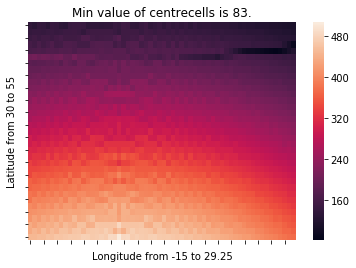

In [92]:
ax = sns.heatmap(np.array(nbrcells).reshape(len(data_dict.keys()), len(lons)))
ax.invert_yaxis()
ax.set_title("Min value of centrecells is 83.")
ax.set_xticklabels([''])
ax.set_yticklabels([''])
ax.set_xlabel('Longitude from -15 to 29.25')
ax.set_ylabel('Latitude from 30 to 55')
plt.savefig(save_dir + "number_of_centre_cell_resampling.png")

In [94]:
idx_lat = np.where(lat_array > 30)

/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in greater
  """Entry point for launching an IPython kernel.


In [95]:
idx_lon = np.where(lon_array > -15)

/home/hanna/anaconda3/envs/sciclouds/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in greater
  """Entry point for launching an IPython kernel.


In [97]:
d_phi.reshape(-1)[idx_lat]  

IndexError: too many indices for array

In [ ]:
d_theta.reshape(-1)[idx_lat]  

In [ ]:
with open(nc_path + 'index_area.json', 'w') as f:
    json.dump(data_dict, f)

In [ ]:
areas = []
lats = np.arange(30, 56, 0.75)
lons = np.arange(-15, 30, 0.75)

for la in lats:
    for lo in lons:
        area = compute_area_one_cell(lat = la, lon = lo, c_lat = lat_array.reshape(-1), 
                              c_lon = lon_array.reshape(-1), d_theta = d_theta_new2.reshape(-1), 
                              d_phi = d_phi_new2.reshape(-1), cloud_mask_array = cloud_mask.reshape(-1)  )
        areas.append(area)

In [15]:
#areas

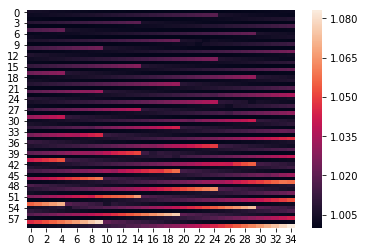

In [16]:
# reshape and make heatmap of aeras.
import seaborn as sns

ax = sns.heatmap((np.array(areas)).reshape(len(lons), len(lats)))
#ax.set_xticklabels(lons)
#ax.set_yticklabels(lats)

In [25]:
lons 

array([-15.  , -14.25, -13.5 , -12.75, -12.  , -11.25, -10.5 ,  -9.75,
        -9.  ,  -8.25,  -7.5 ,  -6.75,  -6.  ,  -5.25,  -4.5 ,  -3.75,
        -3.  ,  -2.25,  -1.5 ,  -0.75,   0.  ,   0.75,   1.5 ,   2.25,
         3.  ,   3.75,   4.5 ,   5.25,   6.  ,   6.75,   7.5 ,   8.25,
         9.  ,   9.75,  10.5 ,  11.25,  12.  ,  12.75,  13.5 ,  14.25,
        15.  ,  15.75,  16.5 ,  17.25,  18.  ,  18.75,  19.5 ,  20.25,
        21.  ,  21.75,  22.5 ,  23.25,  24.  ,  24.75,  25.5 ,  26.25,
        27.  ,  27.75,  28.5 ,  29.25])

In [31]:
xticks

array([-15.  , -12.25,  -9.5 ,  -6.75,  -4.  ,  -1.25,   1.5 ,   4.25,
         7.  ,   9.75,  12.5 ,  15.25,  18.  ,  20.75,  23.5 ,  26.25,
        29.  ])

In [32]:
np.arange()

TypeError: Required argument 'start' (pos 1) not found

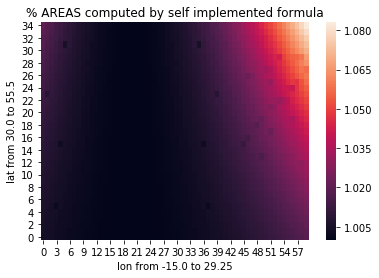

In [36]:
ax = sns.heatmap((np.array(areas)).reshape(len(lats), len(lons)))
ax.invert_yaxis()
ax.set_xlabel("lon from {} to {}".format(min(lons), max(lons)))
ax.set_ylabel("lat from {} to {}".format(min(lats), max(lats)))
#ax.yticklabels(visible = False);
#ax.set_xticklabels(lons);
ax.set_title("% AREAS computed by self implemented formula")
#plt.savefig('test_areas.png')